# Drilling problem forecast
**Project core idea**

"It is easier to land on man on the moon than describing and penetrating a petroleum reservoir successfully" Wrote Pr. Farouq Ali, Indeed, the petroleum engineering is one of the few branches with the lack of the luxurious aspect
of visual during problem solving, and hence tackling the later requires nothing less than approaching it through a diverse set of interconvoluted disciplines.

In fact even if we plan very carefully, it is almost certain that problems related to drilling operations will happen while operating. The slightest of
underestimations could lead to fatal results, ranging from millions of dollars loss in company assets to more critically human lives. Hence understanding and anticipating drilling problems, understanding their causes, and planning solutions are necessary for an overall well cost control which ensures successfully reaching the target zone.

**Problem types**
* Lost cercultion
* Stuck pipe
* Equipement failure

**Data source**
* Treated Dailly Drilling Report and End Well Reports
* Extracted well logs data after digitalization 


# Treated data source
Check the note book in EDM_DDR/Extracted_CSV_data/Well_events/Treatment_for_Geo_Drill_data.ipynb

# 2- Loading data and libreries

<a id="top"></a>

<div class="list-group" id="list-tab" role="tablist">
<h3 class="list-group-item list-group-item-action active" data-toggle="list" style='background:#7ca4cd; border:0' role="tab" aria-controls="home"><center>Libreries</center></h3>

In [ ]:
import numpy as np  # linear algebra
import pandas as pd  # read and wrangle dataframes
import itertools
import os
import glob

# data visualization
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.gridspec as gridspec
import seaborn as sns
import plotly.express as px 
import matplotlib.patches as pathes 
import plotly.graph_objects as go 
from plotly.subplots import make_subplots 
from imblearn.over_sampling import SMOTE 


from sklearn.base import TransformerMixin # To create new classes for transformations
from sklearn.preprocessing import (FunctionTransformer, StandardScaler) # preprocessing 
from sklearn.decomposition import PCA # dimensionality reduction
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from scipy.stats import boxcox # data transform
from sklearn.model_selection import (train_test_split, KFold , StratifiedKFold, 
                                     cross_val_score, GridSearchCV, RandomizedSearchCV,
                                     learning_curve, validation_curve) # model selection modules
from sklearn.pipeline import Pipeline # streaming pipelines
from sklearn.base import BaseEstimator, TransformerMixin # To create a box-cox transformation class
from collections import Counter
import warnings
# load models
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import (XGBClassifier, plot_importance)
from sklearn.svm import SVC
from sklearn.ensemble import (RandomForestClassifier, AdaBoostClassifier, ExtraTreesClassifier, GradientBoostingClassifier)
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from time import time


# Importing the necessary packages
import numpy as np
import pandas as pd


# Deep learning
import keras
from keras.layers import Dense
from keras.models import Sequential
from keras.callbacks import History 
from keras.callbacks import EarlyStopping
from sklearn.model_selection import KFold
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import KFold

# Save the model
import pickle


# Data treatment
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import PowerTransformer
from sklearn.ensemble import IsolationForest
from sklearn.covariance import EllipticEnvelope
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM
from sklearn.preprocessing import LabelEncoder

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
# For Notebooks
init_notebook_mode(connected=True)
# For offline use
cf.go_offline()

# Statistics
from scipy import stats

import warnings

np.random.seed(0)
warnings.filterwarnings('ignore')



%matplotlib inline 
warnings.filterwarnings('ignore')
sns.set_style('whitegrid')

<a id="top"></a>

<div class="list-group" id="list-tab" role="tablist">
<h3 class="list-group-item list-group-item-action active" data-toggle="list" style='background:#7ca4cd; border:0' role="tab" aria-controls="home"><center>load the dataset</center></h3>

In [2]:
# Read the Files 
Csv_file_list = []
path = "C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/"
# View contents of the path
files = os.listdir(path)
files

['15_9-19_SR.csv',
 '15_9-F-1.csv',
 '15_9-F-10.csv',
 '15_9-F-15.csv',
 '15_9-F-4.csv']

In [3]:
Csv_file_list=[]
for file in files:
    if file.lower().endswith('.csv'):
        Csv_file_list.append(path + file)
        
Csv_file_list

['C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-19_SR.csv',
 'C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-F-1.csv',
 'C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-F-10.csv',
 'C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-F-15.csv',
 'C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-F-4.csv']

In [7]:
# Create two data set one as a seperate list
# The second is a concatenated version
df_list=[]
for file in Csv_file_list:
    df.drop('Unnamed: 0', axis=1, inplace=True)
    df = pd.read_csv(file, index_col=None)
    df_list.append(df)
    
for df in df_list:
    df.loc[df.OS == 0, 'OS_cat'] = "Normal condition"
    df.loc[df.OS == 1, 'OS_cat'] = "Lost circulation"
    df.loc[df.OS == 2, 'OS_cat'] = "Stuck equipment"
    df.loc[df.OS == 3, 'OS_cat'] = "Equipment failure"
    
well1, well2, well3, well4, well5=df_list

In [8]:
for i in range(len(df_list)):
        print(f'''Example of the dataset {files[i][:-4]}''')
        display(df_list[i].describe())
        display(df_list[i].head())
        display(df_list[i].info())
        print('\n')

Example of the dataset 15_9-19_SR


,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,RHOB,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,...,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000
mean,269.615159,46.441371,4088.081060,536.721866,-2580.157010,2627.057389,0.034254,79.685748,134.745468,2.451127,...,0.233393,3.948314,36.258091,1193.126724,8123.983701,7168.619357,82.263190,36.772877,0.136730,2736.057389
std,3.785576,5.204897,305.908007,5.605025,220.339997,210.941089,0.181895,18.283591,28.913836,0.164809,...,0.012592,2.288674,5.221088,711.268619,2002.055543,1490.180413,49.040244,26.628705,0.404756,210.941089
min,264.760000,39.610386,3550.206800,522.789000,-2944.101000,2277.297130,0.000000,13.500100,30.078890,1.943000,...,0.197889,0.646352,14.639630,25.007730,4856.279000,4694.406000,1.724223,2.766100,0.000000,2386.297130
25%,267.310025,41.098060,3823.421900,532.991600,-2771.849250,2442.247369,0.000000,66.360625,113.673025,2.322125,...,0.222939,2.333219,32.023187,599.571450,7127.530500,6444.933500,41.339000,15.465375,0.000000,2551.247369
50%,268.981500,47.322250,4088.102600,538.571200,-2592.207000,2614.507581,0.000000,74.786650,126.998000,2.507500,...,0.234561,3.911097,37.297775,1178.699000,8335.747500,7347.378500,81.268410,33.062450,0.000000,2723.507581
75%,269.711575,50.192118,4352.783300,541.221350,-2391.325000,2808.513543,0.000000,93.563075,156.691175,2.586600,...,0.241499,5.018341,39.972192,1596.395000,9017.050750,7836.756500,110.067575,52.237075,0.000000,2917.513543
max,279.079000,55.896879,4617.921200,543.239900,-2174.982000,3009.644621,1.000000,181.813900,296.251900,3.001300,...,0.373871,77.174960,66.230430,10705.170000,71194.590000,54342.590000,738.095500,304.333700,3.000000,3118.644621


,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,DT,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,15/9-19_SR,278.9957,50.544762,3550.2068,523.5649,-2174.982,2277.297130,Hod,0,54.5938,...,6.087025,44.12209,2438.428,9102.264,7645.988,168.1237,55.7555,0,Normal condition,2386.297130
1,15/9-19_SR,278.9970,50.542680,3550.3592,523.5832,-2175.098,2277.393979,Hod,0,54.5938,...,6.087025,44.12209,2438.428,9102.470,7646.194,168.1237,55.0681,0,Normal condition,2386.393979
2,15/9-19_SR,278.9984,50.540597,3550.5116,523.6016,-2175.214,2277.490831,Hod,0,54.5938,...,6.087025,44.12209,2438.428,9102.666,7646.390,168.1237,56.0905,0,Normal condition,2386.490831
3,15/9-19_SR,278.9998,50.538515,3550.6640,523.6199,-2175.331,2277.587688,Hod,0,54.5938,...,6.087025,44.12209,2438.428,9102.861,7646.586,168.1237,58.8310,0,Normal condition,2386.587688
4,15/9-19_SR,279.0012,50.536432,3550.8164,523.6383,-2175.447,2277.684550,Hod,0,54.5938,...,6.087025,44.12209,2438.428,9103.058,7646.782,168.1237,60.3862,0,Normal condition,2386.684550


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6948 entries, 0 to 6947
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   wellName       6948 non-null   object 
 1   Azim           6948 non-null   float64
 2   INCL           6948 non-null   float64
 3   DEPT           6948 non-null   float64
 4   S              6948 non-null   float64
 5   W              6948 non-null   float64
 6   TVDSS          6948 non-null   float64
 7   Zone Name      6948 non-null   object 
 8   MECH_LITHO     6948 non-null   int64  
 9   DT             6948 non-null   float64
 10  DTS            6948 non-null   float64
 11  RHOB           6948 non-null   float64
 12  Resistivity    6948 non-null   float64
 13  PPRS_HP_D      6948 non-null   float64
 14  SVERTICAL_EXT  6948 non-null   float64
 15  PR_STA         6948 non-null   float64
 16  YME_STA        6948 non-null   float64
 17  FANG           6948 non-null   float64
 18  TSTR    

None



Example of the dataset 15_9-F-1


,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,RHOB,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,...,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000
mean,270.105718,31.424479,3107.850000,749.582655,77.682077,2774.040345,0.130116,77.410579,131.147496,2.480931,...,0.233796,26.716890,36.720082,1174.805576,8551.998665,7925.080746,80.999992,48.624734,0.005600,2883.040345
std,106.735326,8.117424,283.551151,105.454531,110.060314,232.093847,0.336448,13.054261,20.644126,0.135899,...,0.008273,7.965001,3.664768,432.883896,1158.270252,1006.832633,29.846294,66.332481,0.074625,232.093847
min,0.013920,20.880032,2616.800000,551.149700,-113.215000,2359.649452,0.000000,50.178200,88.081960,1.801200,...,0.209282,7.267616,23.955320,168.851200,5690.522000,5424.393000,11.641880,1.239300,0.000000,2468.649452
25%,301.587425,26.404176,2862.325000,658.030875,-32.328910,2578.940673,0.000000,69.102175,118.008525,2.425925,...,0.230303,23.024217,35.494960,946.918075,8275.133250,7669.212250,65.287702,11.147825,0.000000,2687.940673
50%,302.803650,28.599315,3107.850000,762.216000,105.308850,2781.174842,0.000000,74.336250,126.285750,2.533200,...,0.234899,27.297175,37.435310,1197.966000,8937.527000,8283.148000,82.596870,34.511900,0.000000,2890.174842
75%,318.329800,37.748845,3353.375000,847.932175,188.379350,2963.655366,0.000000,80.868700,136.616150,2.575600,...,0.239091,31.447240,39.077653,1446.362750,9318.445750,8607.644250,99.723225,53.705750,0.000000,3072.655366
max,359.989100,49.493647,3598.900000,899.431000,200.296000,3189.449781,1.000000,128.763000,212.356700,2.748600,...,0.259774,56.704940,45.831080,2858.552000,11487.400000,10181.710000,197.090200,873.719400,1.000000,3298.449781


,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,DT,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,15/9-F-1,27.08669,28.661639,2616.8,551.1497,183.4050,2359.649452,Lista,1,99.8262,...,14.97298,30.43601,478.5413,6046.584,5690.548,32.99426,79.8456,0,Normal condition,2468.649452
1,15/9-F-1,27.06662,28.657846,2616.9,551.1922,183.4265,2359.737202,Lista,1,99.9305,...,14.95685,30.41022,476.7479,6044.753,5689.086,32.87061,79.6564,0,Normal condition,2468.737202
2,15/9-F-1,27.04655,28.650272,2617.0,551.2347,183.4479,2359.824955,Lista,1,100.1234,...,14.74590,30.36256,473.4486,6022.229,5671.553,32.64313,78.1091,0,Normal condition,2468.824955
3,15/9-F-1,27.02647,28.646488,2617.1,551.2772,183.4693,2359.912713,Lista,1,100.2931,...,14.45612,30.32069,470.5650,5991.516,5647.710,32.44432,76.7843,0,Normal condition,2468.912713
4,15/9-F-1,27.00640,28.642704,2617.2,551.3198,183.4907,2360.000475,Lista,0,100.3768,...,14.22011,30.30006,469.1492,5966.701,5628.497,32.34670,73.6875,0,Normal condition,2469.000475


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9822 entries, 0 to 9821
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   wellName       9822 non-null   object 
 1   Azim           9822 non-null   float64
 2   INCL           9822 non-null   float64
 3   DEPT           9822 non-null   float64
 4   S              9822 non-null   float64
 5   W              9822 non-null   float64
 6   TVDSS          9822 non-null   float64
 7   Zone Name      9822 non-null   object 
 8   MECH_LITHO     9822 non-null   int64  
 9   DT             9822 non-null   float64
 10  DTS            9822 non-null   float64
 11  RHOB           9822 non-null   float64
 12  Resistivity    9822 non-null   float64
 13  PPRS_HP_D      9822 non-null   float64
 14  SVERTICAL_EXT  9822 non-null   float64
 15  PR_STA         9822 non-null   float64
 16  YME_STA        9822 non-null   float64
 17  FANG           9822 non-null   float64
 18  TSTR    

None



Example of the dataset 15_9-F-10


,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,RHOB,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,3070.00000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,...,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000
mean,130.81789,58.054494,5083.987800,-1892.487962,2787.548333,2730.608404,0.443974,75.066707,127.440873,2.488406,...,0.234607,26.922198,37.257297,1190.351239,8978.018558,7713.659192,82.071830,75.727235,0.066450,2839.608404
std,0.99784,5.930928,135.083853,73.970410,84.753012,74.361370,0.496932,5.700864,9.015396,0.121372,...,0.004077,4.827647,1.701884,226.100060,547.709836,395.261441,15.589052,75.652717,0.358504,74.361370
min,129.21000,54.140919,4850.130000,-2018.729000,2633.484000,2617.211002,0.000000,60.445170,104.318200,2.130200,...,0.223810,15.308870,32.459950,636.754900,7733.532000,6815.628000,43.902700,4.015600,0.000000,2726.211002
25%,130.13000,54.509736,4967.058900,-1956.717500,2716.568500,2661.790586,0.000000,71.234210,121.380100,2.420325,...,0.232059,23.670572,36.254795,1039.988000,8602.392750,7420.573750,71.704660,19.241175,0.000000,2770.790586
50%,130.93445,54.610002,5083.987800,-1893.160500,2789.270500,2727.736756,0.000000,73.098930,124.329000,2.530300,...,0.235845,28.191130,37.816160,1252.534000,8862.235000,7562.957500,86.359200,45.517850,0.000000,2836.736756
75%,131.71925,59.926792,5200.916700,-1829.346500,2860.275500,2795.521697,1.000000,78.264477,132.497850,2.570000,...,0.237322,30.077520,38.398640,1339.503000,9345.326500,8029.109250,92.355480,122.322500,0.000000,2904.521697
max,132.53000,74.356052,5317.845600,-1761.012000,2932.375000,2863.486515,1.000000,91.891690,154.048100,2.799700,...,0.247283,44.717480,41.991170,1975.268000,11678.540000,9598.588000,136.190000,813.930700,2.000000,2972.486515


,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,DT,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,15/9-F-10,129.4500,74.356052,4850.1300,-1761.012,2633.484,2617.211002,Hod,0,72.17362,...,29.10843,38.10390,1294.960,8665.131,7299.476,89.28437,9.7900,0,Normal condition,2726.211002
1,15/9-F-10,129.4483,74.341567,4850.2824,-1761.106,2633.598,2617.252117,Hod,0,73.59212,...,27.71667,37.66382,1230.492,8490.137,7188.614,84.83945,11.2587,0,Normal condition,2726.252117
2,15/9-F-10,129.4467,74.327081,4850.4348,-1761.200,2633.712,2617.293268,Hod,0,73.95379,...,27.37493,37.55256,1214.575,8447.243,7161.481,83.74198,9.9104,0,Normal condition,2726.293268
3,15/9-F-10,129.4450,74.312596,4850.5872,-1761.294,2633.826,2617.334457,Hod,0,70.82088,...,30.51650,38.52918,1359.584,8842.598,7412.140,93.74003,8.6531,0,Normal condition,2726.334457
4,15/9-F-10,129.4433,74.298110,4850.7396,-1761.388,2633.940,2617.375683,Hod,0,72.17362,...,29.10843,38.10390,1294.960,8665.481,7299.827,89.28437,7.3100,0,Normal condition,2726.375683


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3070 entries, 0 to 3069
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   wellName       3070 non-null   object 
 1   Azim           3070 non-null   float64
 2   INCL           3070 non-null   float64
 3   DEPT           3070 non-null   float64
 4   S              3070 non-null   float64
 5   W              3070 non-null   float64
 6   TVDSS          3070 non-null   float64
 7   Zone Name      3070 non-null   object 
 8   MECH_LITHO     3070 non-null   int64  
 9   DT             3070 non-null   float64
 10  DTS            3070 non-null   float64
 11  RHOB           3070 non-null   float64
 12  Resistivity    3070 non-null   float64
 13  PPRS_HP_D      3070 non-null   float64
 14  SVERTICAL_EXT  3070 non-null   float64
 15  PR_STA         3070 non-null   float64
 16  YME_STA        3070 non-null   float64
 17  FANG           3070 non-null   float64
 18  TSTR    

None



Example of the dataset 15_9-F-15


,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,RHOB,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,...,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000
mean,203.074932,57.918659,3299.231400,-1196.722175,-688.069799,2606.408163,0.099042,78.810933,133.362027,2.459061,...,0.233864,27.395527,36.498379,1215.267993,8527.846505,7244.647265,83.789777,40.008698,0.108427,2715.408163
std,2.687153,9.853125,440.666807,357.595854,147.478738,204.897799,0.298733,18.015995,28.490657,0.160245,...,0.011647,11.465139,5.087206,620.203830,1604.934976,1104.909518,42.761548,57.309404,0.400978,204.897799
min,197.670000,33.045316,2536.088400,-1786.743000,-936.876500,2206.463116,0.000000,52.269000,91.388370,1.554800,...,0.208258,6.915116,23.236500,148.463500,5245.417000,4863.423000,10.236200,4.405700,0.000000,2315.463116
25%,201.201200,50.346348,2917.659900,-1519.617250,-819.913375,2449.737307,0.000000,64.063775,110.040750,2.319450,...,0.224752,17.116335,32.924285,678.231050,6978.068000,6223.159250,46.762390,12.573675,0.000000,2558.737307
50%,202.421700,63.576720,3299.231400,-1198.390500,-688.568700,2603.075098,0.000000,73.096700,124.325500,2.524900,...,0.235847,27.946540,37.816845,1252.635000,8837.477500,7544.484000,86.366140,27.543100,0.000000,2712.075098
75%,204.870700,66.116298,3680.802900,-875.364300,-555.737275,2760.473184,0.000000,90.138825,151.276025,2.590000,...,0.243643,36.816960,40.741147,1734.006000,9804.621000,8090.230250,119.555550,46.741525,0.000000,2869.473184
max,210.480000,67.689538,4062.374400,-613.438500,-441.841500,3004.251692,1.000000,132.337400,218.009300,2.981000,...,0.256926,55.362170,45.010240,2651.290000,12376.950000,9830.497000,182.800000,1068.505000,3.000000,3113.251692


,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,DT,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,15/9-F-15,207.3105,33.045316,2536.0884,-613.4385,-441.8415,2206.463116,Skade,0,130.3142,...,8.188940,23.64143,159.6805,5269.317,4876.308,11.00958,45.8342,1,Lost circulation,2315.463116
1,15/9-F-15,207.3084,33.052272,2536.2408,-613.5140,-441.8801,2206.590858,Skade,0,130.3142,...,8.191495,23.64143,159.6805,5269.868,4876.736,11.00958,46.7654,1,Lost circulation,2315.590858
2,15/9-F-15,207.3063,33.059228,2536.3932,-613.5894,-441.9186,2206.718591,Skade,0,130.3142,...,8.209019,23.64143,159.6805,5272.150,4878.177,11.00958,46.5333,1,Lost circulation,2315.718591
3,15/9-F-15,207.3042,33.066184,2536.5456,-613.6648,-441.9572,2206.846313,Skade,0,130.3142,...,8.206098,23.64143,159.6805,5272.067,4878.234,11.00958,44.5765,1,Lost circulation,2315.846313
4,15/9-F-15,207.3020,33.073140,2536.6980,-613.7402,-441.9958,2206.974026,Skade,0,130.3142,...,8.280208,23.64143,159.6805,5280.894,4883.504,11.00958,45.8534,1,Lost circulation,2315.974026


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10016 entries, 0 to 10015
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   wellName       10016 non-null  object 
 1   Azim           10016 non-null  float64
 2   INCL           10016 non-null  float64
 3   DEPT           10016 non-null  float64
 4   S              10016 non-null  float64
 5   W              10016 non-null  float64
 6   TVDSS          10016 non-null  float64
 7   Zone Name      10016 non-null  object 
 8   MECH_LITHO     10016 non-null  int64  
 9   DT             10016 non-null  float64
 10  DTS            10016 non-null  float64
 11  RHOB           10016 non-null  float64
 12  Resistivity    10016 non-null  float64
 13  PPRS_HP_D      10016 non-null  float64
 14  SVERTICAL_EXT  10016 non-null  float64
 15  PR_STA         10016 non-null  float64
 16  YME_STA        10016 non-null  float64
 17  FANG           10016 non-null  float64
 18  TSTR  

None



Example of the dataset 15_9-F-4


,Unnamed: 0,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,...,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000
mean,76557.500000,176.589119,42.577550,3117.037200,-606.899602,654.226888,2733.297066,0.190031,78.140018,144.542080,...,0.291176,22.315547,36.520448,1157.363484,9109.222818,8361.246510,79.797402,45.622633,0.002700,2842.297066
std,5560.027428,18.929383,9.328957,211.837041,137.221150,19.556138,155.624650,0.392336,13.414504,18.606224,...,0.063729,7.267914,3.836893,482.594851,808.865191,676.608719,33.273743,48.102645,0.072008,155.624650
min,66928.000000,135.494200,30.067902,2750.210400,-866.585700,612.243400,2443.884854,0.000000,53.358000,74.386700,...,0.057748,7.441253,23.552200,157.150100,-6774.975000,-9395.920000,10.835120,5.374700,0.000000,2552.884854
25%,71742.750000,161.184200,33.335540,2933.547600,-723.769000,638.612000,2599.672964,0.000000,67.192200,130.156700,...,0.242241,17.186520,33.745560,756.685000,8660.216000,8022.556000,52.171590,13.956300,0.000000,2708.672964
50%,76557.500000,182.940400,40.508857,3117.037200,-590.920300,658.631100,2747.455791,0.000000,76.447200,142.649000,...,0.309374,21.472310,36.795640,1110.301000,9045.148000,8339.477000,76.552570,27.989100,0.000000,2856.455791
75%,81372.250000,193.896700,53.449512,3300.526800,-484.624000,672.191900,2871.603132,0.000000,87.098300,156.368300,...,0.327651,27.406500,39.698240,1549.313000,9650.935000,8764.921000,106.821300,54.701500,0.000000,2980.603132
max,86187.000000,202.646000,55.229906,3483.864000,-401.453600,677.744900,2977.049504,1.000000,130.757900,215.511400,...,3.264716,256.889100,44.591080,2549.360000,12322.770000,11282.690000,175.772200,469.738000,3.000000,3086.049504


,Unnamed: 0,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,66928,15/9-F-4,135.4942,30.067902,2750.2104,-401.4536,612.3137,2443.884854,Vale,0,...,24.75178,38.18847,1307.629,7885.207,7014.415,90.15782,12.3721,0,Normal condition,2552.884854
1,66929,15/9-F-4,135.4942,30.067902,2750.2104,-401.4536,612.3137,2443.884854,Vale,0,...,24.75178,38.18847,1307.629,7885.207,7014.415,90.15782,12.3721,0,Normal condition,2552.884854
2,66930,15/9-F-4,135.4942,30.067902,2750.2104,-401.4536,612.3137,2443.884854,Vale,0,...,24.75178,38.18847,1307.629,7885.207,7014.415,90.15782,12.3721,0,Normal condition,2552.884854
3,66931,15/9-F-4,135.4942,30.067902,2750.2104,-401.4536,612.3137,2443.884854,Vale,0,...,24.75178,38.18847,1307.629,7885.207,7014.415,90.15782,12.3721,0,Normal condition,2552.884854
4,66932,15/9-F-4,135.5232,30.075198,2750.3628,-401.5099,612.3664,2444.016741,Vale,0,...,20.61230,35.48936,946.257,7326.968,6597.979,65.24212,11.9165,0,Normal condition,2553.016741


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19260 entries, 0 to 19259
Data columns (total 27 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0     19260 non-null  int64  
 1   wellName       19260 non-null  object 
 2   Azim           19260 non-null  float64
 3   INCL           19260 non-null  float64
 4   DEPT           19260 non-null  float64
 5   S              19260 non-null  float64
 6   W              19260 non-null  float64
 7   TVDSS          19260 non-null  float64
 8   Zone Name      19260 non-null  object 
 9   MECH_LITHO     19260 non-null  int64  
 10  DT             19260 non-null  float64
 11  DTS            19260 non-null  float64
 12  RHOB           19260 non-null  float64
 13  Resistivity    19260 non-null  float64
 14  PPRS_HP_D      19260 non-null  float64
 15  SVERTICAL_EXT  19260 non-null  float64
 16  PR_STA         19260 non-null  float64
 17  YME_STA        19260 non-null  float64
 18  FANG  

None

In [ ]:
#Drilling_data=[]
#Drilling_data = pd.concat(df_list)
#df=Drilling_data.copy()

In [ ]:
#All_columns=[]
#for df in df_list:
#    col=list(df.columns)
#    All_columns.append(col)

    
#for ele in CC:
#    if ele in All_columns:
#        All_columns.remove(ele)

# Not in commune values

In [9]:
# Separation for list of dataframes
num_dfs=[]
for df in df_list:
    num_df=df.select_dtypes(include=np.number)
    num_dfs.append(num_df)
    
cat_dfs=[]
for df in df_list:
    cat_df=df.select_dtypes(include=np.number)
    cat_dfs.append(cat_df)
    

num_data=df_list[0].select_dtypes(include=np.number)
num_cols=num_data.columns.tolist()

cat_data=df_list[0].select_dtypes(exclude=np.number)
cat_cols=cat_data.columns.tolist()

In [10]:
cat_cols

['wellName', 'Zone Name', 'OS_cat']

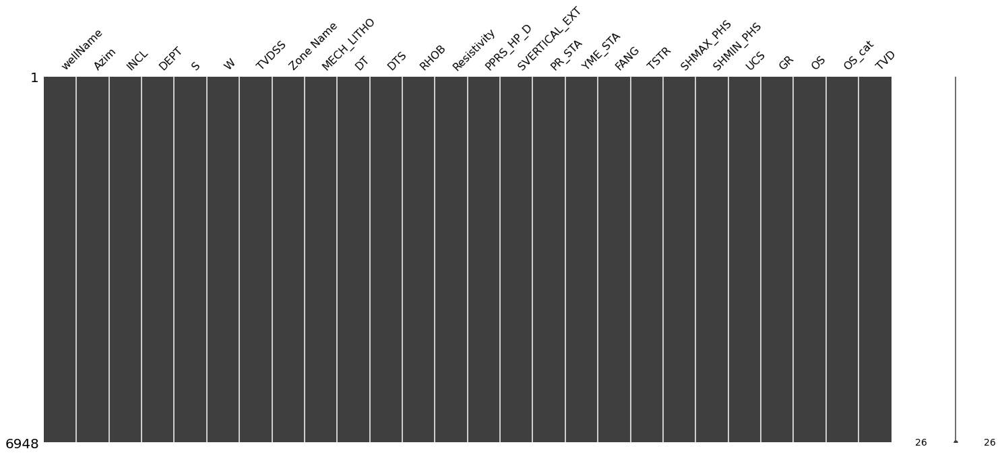

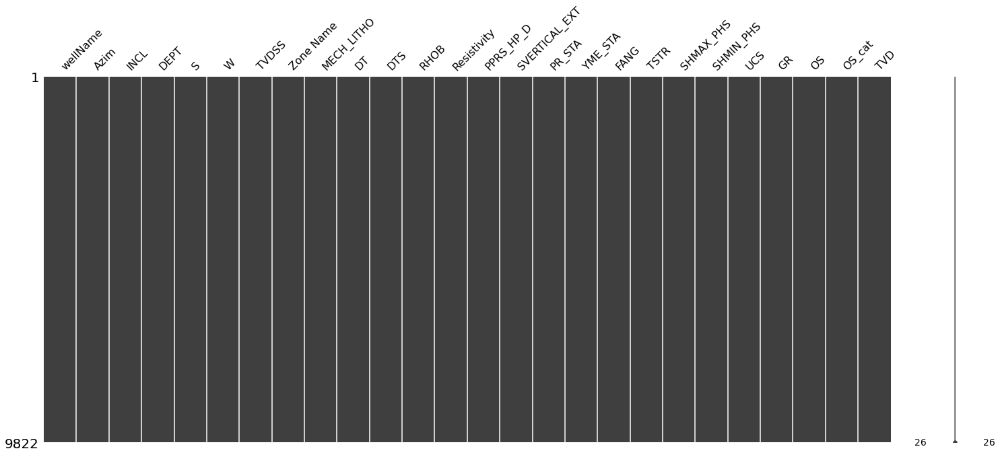

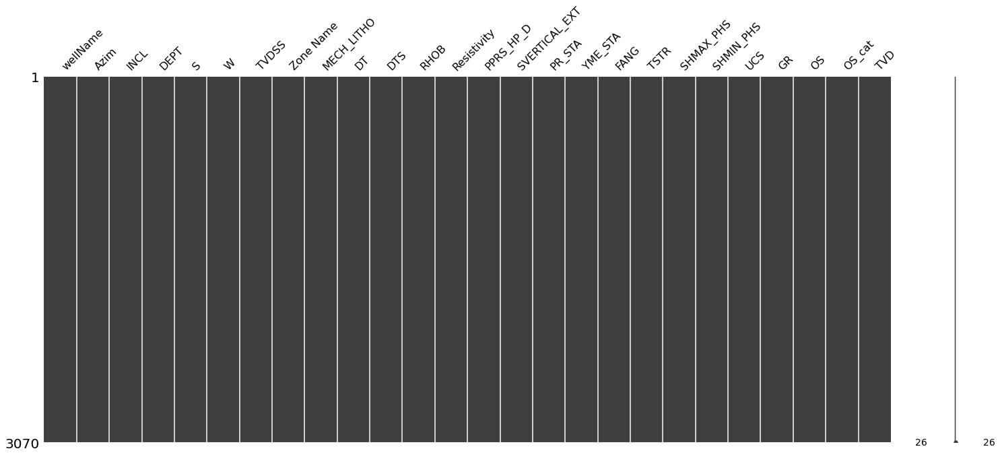

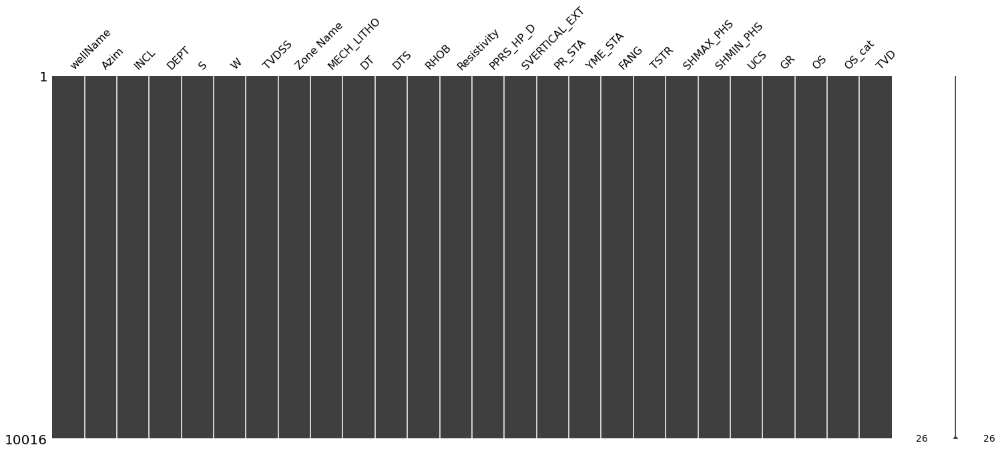

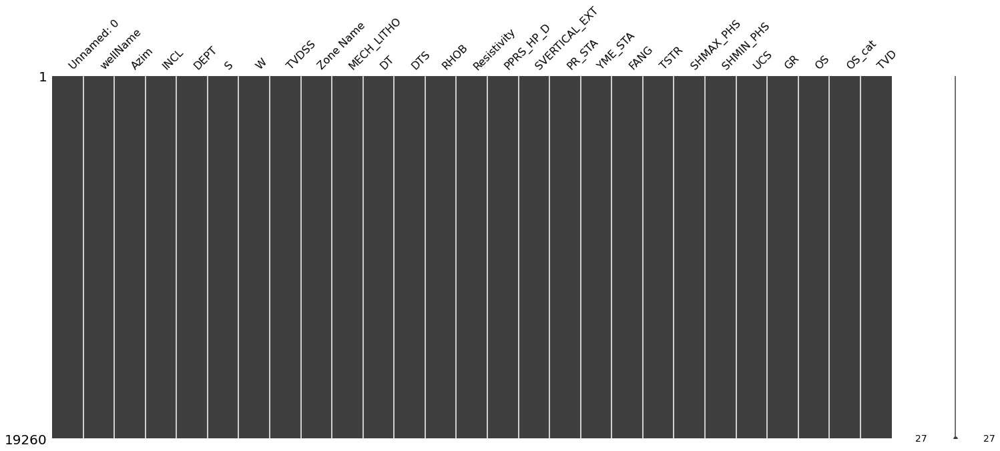

In [11]:
# Data couvrage
for df in df_list:
    msno.matrix(df)

In [ ]:
#label = LabelEncoder()
#for df in df_list: 
#    for cat in cat_cols:
#        df[cat] = label.fit_transform(df[cat])

In [12]:
Backup_1= df_list.copy()

In [13]:
All_wells= pd.concat(df_list)
All_wells['wellName'].value_counts()

15/9-F-4      19260
15/9-F-15     10016
15/9-F-1       9822
15/9-19_SR     6948
15/9-F-10      3070
Name: wellName, dtype: int64

In [14]:
cat_cols.remove('wellName')
cat_cols

['Zone Name', 'OS_cat']

In [15]:
label = LabelEncoder()
for cat in cat_cols:
    All_wells[cat]=label.fit_transform(All_wells[cat])

In [16]:
All_wells.reset_index(inplace=True)
All_wells.drop('index', axis=1, inplace=True)
All_wells

,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,DT,...,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD,Unnamed: 0
0,15/9-19_SR,278.9957,50.544762,3550.2068,523.5649,-2174.9820,2277.297130,6,0,54.5938,...,44.12209,2438.428,9102.264,7645.988,168.12370,55.7555,0,2,2386.297130,NaN
1,15/9-19_SR,278.9970,50.542680,3550.3592,523.5832,-2175.0980,2277.393979,6,0,54.5938,...,44.12209,2438.428,9102.470,7646.194,168.12370,55.0681,0,2,2386.393979,NaN
2,15/9-19_SR,278.9984,50.540597,3550.5116,523.6016,-2175.2140,2277.490831,6,0,54.5938,...,44.12209,2438.428,9102.666,7646.390,168.12370,56.0905,0,2,2386.490831,NaN
3,15/9-19_SR,278.9998,50.538515,3550.6640,523.6199,-2175.3310,2277.587688,6,0,54.5938,...,44.12209,2438.428,9102.861,7646.586,168.12370,58.8310,0,2,2386.587688,NaN
4,15/9-19_SR,279.0012,50.536432,3550.8164,523.6383,-2175.4470,2277.684550,6,0,54.5938,...,44.12209,2438.428,9103.058,7646.782,168.12370,60.3862,0,2,2386.684550,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49111,15/9-F-4,202.6354,54.675734,3483.7116,-866.4697,612.2887,2976.961385,12,1,77.6191,...,36.44585,1064.433,8964.568,8068.737,73.39011,103.8802,0,2,3085.961385,86183.0
49112,15/9-F-4,202.6460,54.675052,3483.8640,-866.5857,612.2434,2977.049504,12,1,73.6478,...,37.64667,1228.028,9349.445,8353.748,84.66956,104.2843,0,2,3086.049504,86184.0
49113,15/9-F-4,202.6460,54.675052,3483.8640,-866.5857,612.2434,2977.049504,12,1,73.6478,...,37.64667,1228.028,9349.445,8353.748,84.66956,104.2843,0,2,3086.049504,86185.0
49114,15/9-F-4,202.6460,54.675052,3483.8640,-866.5857,612.2434,2977.049504,12,1,73.6478,...,37.64667,1228.028,9349.445,8353.748,84.66956,104.2843,0,2,3086.049504,86186.0


In [17]:
All_wells.columns

Index(['wellName', 'Azim', 'INCL', 'DEPT', 'S', 'W', 'TVDSS', 'Zone Name',
       'MECH_LITHO', 'DT', 'DTS', 'RHOB', 'Resistivity', 'PPRS_HP_D',
       'SVERTICAL_EXT', 'PR_STA', 'YME_STA', 'FANG', 'TSTR', 'SHMAX_PHS',
       'SHMIN_PHS', 'UCS', 'GR', 'OS', 'OS_cat', 'TVD', 'Unnamed: 0'],
      dtype='object')

In [18]:
well1= All_wells.loc[All_wells['wellName'] == "15/9-F-4"]
well2= All_wells.loc[All_wells['wellName'] == "15/9-F-15"]
well3= All_wells.loc[All_wells['wellName'] == "15/9-F-1"]
well4= All_wells.loc[All_wells['wellName'] == "15/9-19_SR"]
well5= All_wells.loc[All_wells['wellName'] == "15/9-F-10"]

In [19]:
df_list=[well1, well2, well3, well4, well5]

In [20]:
for df in df_list:
    df.loc[df.GR > 200, 'GR'] = 200
    df.Resistivity=np.log(df.Resistivity)    

<a id="top"></a>

<div class="list-group" id="list-tab" role="tablist">
<h3 class="list-group-item list-group-item-action active" data-toggle="list" style='background:#7ca4cd; border:0' role="tab" aria-controls="home"><center>Predicting using Well logs only</center></h3>

In [21]:
df_list[0].columns

Index(['wellName', 'Azim', 'INCL', 'DEPT', 'S', 'W', 'TVDSS', 'Zone Name',
       'MECH_LITHO', 'DT', 'DTS', 'RHOB', 'Resistivity', 'PPRS_HP_D',
       'SVERTICAL_EXT', 'PR_STA', 'YME_STA', 'FANG', 'TSTR', 'SHMAX_PHS',
       'SHMIN_PHS', 'UCS', 'GR', 'OS', 'OS_cat', 'TVD', 'Unnamed: 0'],
      dtype='object')

In [22]:
for df in df_list:
    df.rename({'DEPT':'MD'}, axis=1, inplace=True)

In [23]:
# We will use 4 well for taining and one for prediction
# train columns to use
well_df=df_list.copy()

train_cols =['MD','Azim', 'INCL','GR', 'Resistivity', 'DT', 'DTS', 'RHOB','OS']

# test columns to use
test_cols =[ 'MD', 'Azim', 'INCL','GR', 'Resistivity', 'DT', 'DTS', 'RHOB' ]
well_df_restrict = [0] * 5

for i in range(len(well_df)):
    if i <= 3:
        # the train data, drop unwanted columns
        well_df_restrict[i] = well_df[i][train_cols]
  
    else:
        # the test data, drop unwanted columns
        well_df_restrict[i] = well_df[i][test_cols]

well1, well2, well3, well4, well5 = well_df_restrict

# as we can see, both ends already not have NaNs
well5

,MD,Azim,INCL,GR,Resistivity,DT,DTS,RHOB
16770,4850.1300,129.4500,74.356052,9.7900,0.912283,72.17362,122.8657,2.5500
16771,4850.2824,129.4483,74.341567,11.2587,0.914930,73.59212,125.1089,2.5198
16772,4850.4348,129.4467,74.327081,9.9104,1.065331,73.95379,125.6809,2.5121
16773,4850.5872,129.4450,74.312596,8.6531,1.084851,70.82088,120.7265,2.5788
16774,4850.7396,129.4433,74.298110,7.3100,1.085189,72.17362,122.8657,2.5500
...,...,...,...,...,...,...,...,...
19835,5317.2360,130.1300,54.610002,102.9860,0.582495,71.23421,121.3801,2.5700
19836,5317.3884,130.1300,54.610002,101.7534,0.587731,71.23421,121.3801,2.5700
19837,5317.5408,130.1300,54.610002,101.0188,0.614861,71.23891,121.3876,2.5699
19838,5317.6932,130.1300,54.610002,100.7660,0.547775,71.70392,122.1229,2.5600


In [31]:
#well5.to_csv("C:/Users/DELL/Desktop/data examples/Problem_forecast_example.csv")

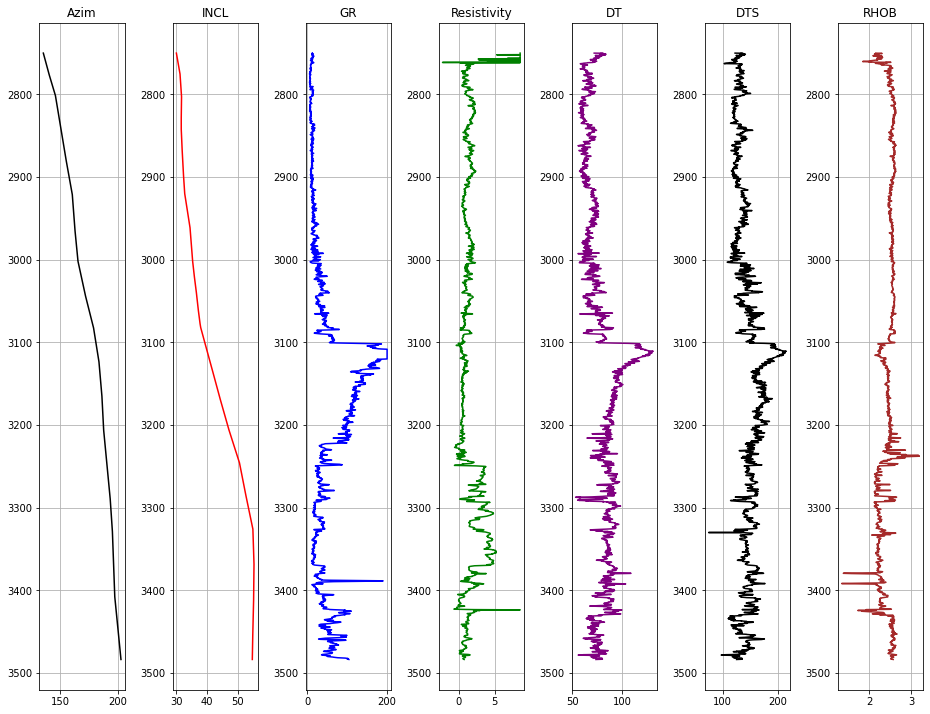

In [24]:
# Display the test data
well = well1

# define what data we wanna plot are we going to us
logs =['Azim', 'INCL','GR', 'Resistivity', 'DT', 'DTS', 'RHOB']

# create the subplots; ncols equals the number of logs
fig, ax = plt.subplots(nrows=1, ncols=len(logs), figsize=(13,10))

# looping each log to display in the subplots

colors = ['black', 'red', 'blue', 'green', 'purple', 'black','brown']

for i in range(len(logs)):
    ax[i].plot(well[logs[i]], well.MD, color=colors[i])

    ax[i].set_title(logs[i])
    ax[i].grid(True)
    ax[i].invert_yaxis()

plt.tight_layout(1)
plt.show()

# 3- Exploratory data analysis

In [25]:
# Putting each similar feature togheter to analyze it's distribution

'''15/9-F-15_final    53039
15/9-F-15 A        51708
15/9-F-14          47643
15/9-F-5           18548
15/9-F-9 A         13746
15/9-F-9            7851
15/9-F-7            6389'''

box_data=df_list.copy()

for df in box_data:
    df.reset_index(inplace=True)

data=[]
def Feature_all(feature):
    df=pd.DataFrame()

    for i in range(len(box_data)):
                for j in box_data[i].columns:
                    if j==str(feature):
                        df[i]=box_data[i][j]
                        #data.append(df[i])
    df.boxplot(figsize=(12,7))
    plt.xticks([1, 2, 3, 4, 5], ['15_9-19_SR', '15_9-F-1', '15_9-F-10', '15_9-F-15', '15_9-F-4'])


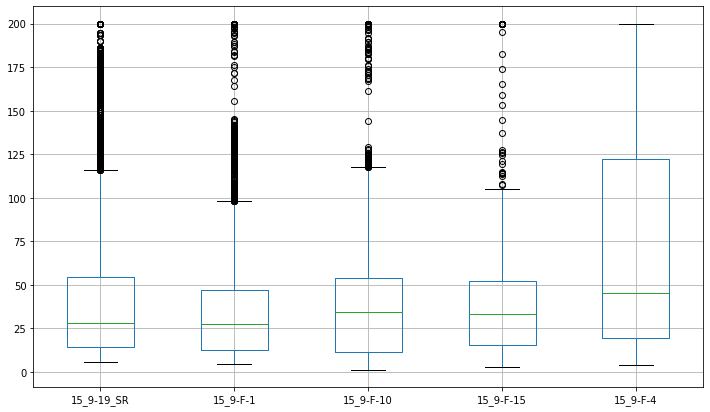

In [26]:
Feature_all('GR')

## - Data treatment
### a- Data Normalization

Normalize the dataset:
* Log transform the RT log
* Use power transform with Yeo-Johnson method

# HERE !

In [27]:
well_train = pd.concat([well1, well2, well3, well4])
well_pred = pd.concat([well5])

well4

,MD,Azim,INCL,GR,Resistivity,DT,DTS,RHOB,OS
0,3550.2068,278.9957,50.544762,55.7555,0.062787,54.5938,95.06483,2.1705,0
1,3550.3592,278.9970,50.542680,55.0681,0.025863,54.5938,95.06483,2.1705,0
2,3550.5116,278.9984,50.540597,56.0905,-0.002303,54.5938,95.06483,2.1705,0
3,3550.6640,278.9998,50.538515,58.8310,-0.005917,54.5938,95.06483,2.1705,0
4,3550.8164,279.0012,50.536432,60.3862,0.199179,54.5938,95.06483,2.1705,0
...,...,...,...,...,...,...,...,...,...
6943,4617.3116,264.7600,41.299999,87.1958,0.757904,40.0000,71.98607,2.5547,0
6944,4617.4640,264.7600,41.299999,90.9071,0.735488,40.0000,71.98607,2.5662,0
6945,4617.6164,264.7600,41.299999,86.2190,0.715936,40.0000,71.98607,2.5702,0
6946,4617.7688,264.7600,41.299999,74.8791,0.689390,40.0000,71.98607,2.5674,0


In [28]:
# merge dataframes
well_train=[]
well_pred=[]

well_train = pd.concat([well1, well2, well3, well4])
well_pred = pd.concat([well5]) # 15_9-F-4


# assign names

names= ['15_9-19_SR', '15_9-F-1', '15_9-F-10', '15_9-F-15', '15_9-F-4']
names_train = []
names_pred = []
for i in range(len(well_df_restrict)):
    if i  <= 3:
        # train data, assign names 
        _ = np.full(len(well_df_restrict[i]), names[i])
        names_train.append(_)
    else:
        # test data, assign names
        _ = np.full(len(well_df_restrict[i]), names[i])
        names_pred.append(_)

# concatenate inside list
import itertools

names_train = list(itertools.chain.from_iterable(names_train))
names_pred = list(itertools.chain.from_iterable(names_pred))

# include well names to the train and pred dataframe
well_train['WELL'] = names_train
well_pred['WELL'] = names_pred

# move the depth column to the right
depth_train, depth_pred = well_train.pop('MD'), well_pred.pop('MD')
well_train['MD'], well_pred['MD'] = depth_train, depth_pred

well_train['OS'].value_counts()

0    44323
1     1387
2      252
3       84
Name: OS, dtype: int64

In [29]:
train_features = ['Azim', 'INCL','GR', 'Resistivity', 'DT', 'DTS', 'RHOB', 'OS']

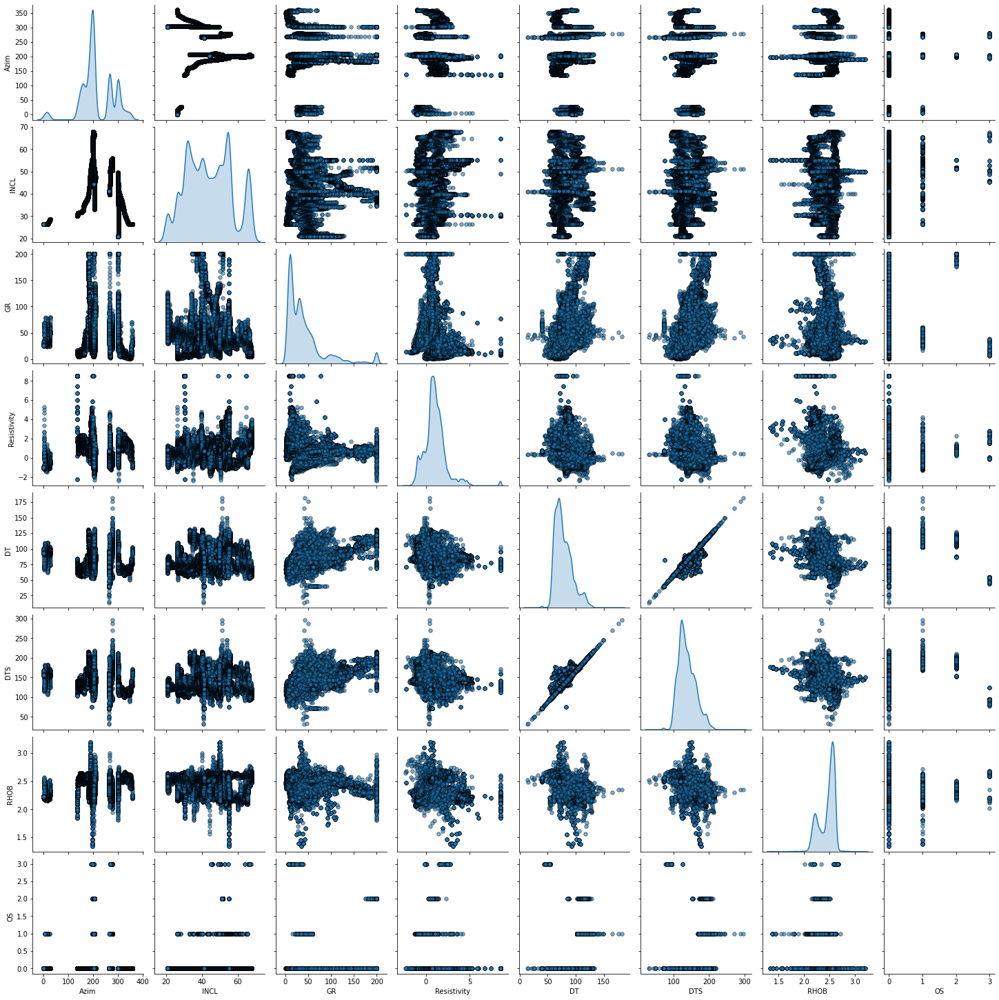

In [42]:
sns.pairplot(well_train, vars=train_features, diag_kind='kde',
             plot_kws = {'alpha': 0.6, 's': 30, 'edgecolor': 'k'})

In [30]:
well_train_only_features = well_train[train_features]

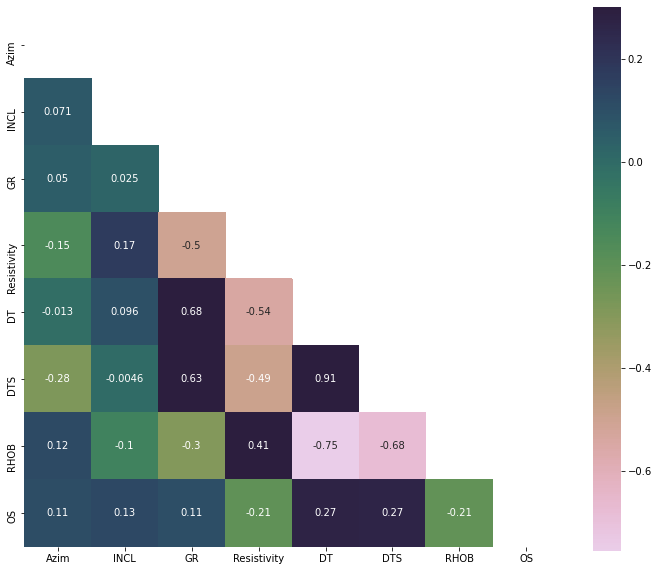

In [44]:
# Generate a mask for the upper triangle
mask = np.zeros_like(well_train_only_features.corr(method = 'spearman') , dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Generate a custom diverging colormap
cmap = sns.cubehelix_palette(n_colors=12, start=-2.25, rot=-1.3, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
plt.figure(figsize=(12,10))
sns.heatmap(well_train_only_features.corr(method = 'spearman') ,annot=True,  mask=mask, cmap=cmap, vmax=.3, square=True)

plt.show()

## - Data treatment
### a- Data Normalization


In [31]:
colnames = well_train.columns
only_feature = ['Azim', 'INCL','GR', 'Resistivity', 'DT', 'DTS', 'RHOB']# only feature column names
only_target = 'OS' # only target column names
feature_target = np.append(only_feature, only_target) # feature and target column names

colnames

Index(['Azim', 'INCL', 'GR', 'Resistivity', 'DT', 'DTS', 'RHOB', 'OS', 'WELL',
       'MD'],
      dtype='object')

In [32]:
well_train['OS'].value_counts()

0    44323
1     1387
2      252
3       84
Name: OS, dtype: int64

In [ ]:
#scaler=StandardScaler()
#column_drop = ['WELL', 'Depth m']

## fit and transform
#well_train_norm = scaler.fit_transform(well_train[['Azim', 'INCL','GR', 'Resistivity', 'DT', 'DTS', 'RHOB']])

In [ ]:
#well_train_norm

In [ ]:
## convert to dataframe
#well_train_norm = pd.DataFrame(well_train_norm, columns=colnames)
#well_train_norm

In [33]:
well_train.OS.value_counts()

0    44323
1     1387
2      252
3       84
Name: OS, dtype: int64

In [33]:
well_train

,Azim,INCL,GR,Resistivity,DT,DTS,RHOB,OS,WELL,MD
29856,135.4942,30.067902,12.3721,8.517193,71.9032,122.43810,2.1529,0,15_9-19_SR,2750.2104
29857,135.4942,30.067902,12.3721,8.517193,71.9032,122.43810,2.1529,0,15_9-19_SR,2750.2104
29858,135.4942,30.067902,12.3721,8.517193,71.9032,122.43810,2.1529,0,15_9-19_SR,2750.2104
29859,135.4942,30.067902,12.3721,8.517193,71.9032,122.43810,2.1529,0,15_9-19_SR,2750.2104
29860,135.5232,30.075198,11.9165,8.517193,80.8881,136.64690,2.2449,0,15_9-19_SR,2750.3628
...,...,...,...,...,...,...,...,...,...,...
6943,264.7600,41.299999,87.1958,0.757904,40.0000,71.98607,2.5547,0,15_9-F-15,4617.3116
6944,264.7600,41.299999,90.9071,0.735488,40.0000,71.98607,2.5662,0,15_9-F-15,4617.4640
6945,264.7600,41.299999,86.2190,0.715936,40.0000,71.98607,2.5702,0,15_9-F-15,4617.6164
6946,264.7600,41.299999,74.8791,0.689390,40.0000,71.98607,2.5674,0,15_9-F-15,4617.7688


In [34]:
y = well_train['WELL'].astype(str)
z = well_train['MD'].astype(float)
os = well_train['OS'].astype(float)

In [35]:
y = well_train['WELL'].astype(str)
y= pd.DataFrame(y, columns=['WELL'])
y= y.reset_index()
y.drop('index', axis=1, inplace=True)
y


,WELL
0,15_9-19_SR
1,15_9-19_SR
2,15_9-19_SR
3,15_9-19_SR
4,15_9-19_SR
...,...
46041,15_9-F-15
46042,15_9-F-15
46043,15_9-F-15
46044,15_9-F-15


In [36]:
z = well_train['MD'].astype(float)
z= pd.DataFrame(z, columns=['MD'])
z= z.reset_index()
z.drop('index', axis=1, inplace=True)
z


,MD
0,2750.2104
1,2750.2104
2,2750.2104
3,2750.2104
4,2750.3628
...,...
46041,4617.3116
46042,4617.4640
46043,4617.6164
46044,4617.7688


In [37]:
os = well_train['OS'].astype(int)
os= pd.DataFrame(os, columns=['OS'])
os= os.reset_index()
os.drop('index', axis=1, inplace=True)
os

,OS
0,0
1,0
2,0
3,0
4,0
...,...
46041,0
46042,0
46043,0
46044,0


In [38]:
scaler = PowerTransformer(method='yeo-johnson')
scaler= scaler.fit(well_train[only_feature])

well_train_norm= scaler.transform(well_train[only_feature])
well_train_norm = pd.DataFrame(well_train_norm, columns=only_feature)


import pickle
pickle.dump(scaler, open('Prob_pre_scaler_.pkl','wb'))

In [39]:
well_train_norm

,Azim,INCL,GR,Resistivity,DT,DTS,RHOB
0,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119
1,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119
2,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119
3,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119
4,-1.241369,-1.151296,-0.939731,4.282526,0.315880,0.055573,-1.338918
...,...,...,...,...,...,...,...
46041,0.736004,-0.170948,1.254626,-0.129737,-4.205519,-3.956989,0.587579
46042,0.736004,-0.170948,1.300356,-0.149319,-4.205519,-3.956989,0.683043
46043,0.736004,-0.170948,1.242260,-0.166486,-4.205519,-3.956989,0.716722
46044,0.736004,-0.170948,1.087271,-0.189922,-4.205519,-3.956989,0.693121


In [ ]:
# normalize using power transform Yeo-Johnson method
#scaler = PowerTransformer(method='yeo-johnson')

## ColumnTransformer
#column_drop = ['WELL', 'Depth m']
#ct = ColumnTransformer([('transform', scaler, only_feature)], remainder='passthrough')

## fit and transform
#well_train_norm = ct.fit_transform(well_train)

## convert to dataframe
#well_train_norm = pd.DataFrame(well_train_norm, columns=colnames)
#well_train_norm

In [40]:
well_train_norm

,Azim,INCL,GR,Resistivity,DT,DTS,RHOB
0,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119
1,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119
2,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119
3,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119
4,-1.241369,-1.151296,-0.939731,4.282526,0.315880,0.055573,-1.338918
...,...,...,...,...,...,...,...
46041,0.736004,-0.170948,1.254626,-0.129737,-4.205519,-3.956989,0.587579
46042,0.736004,-0.170948,1.300356,-0.149319,-4.205519,-3.956989,0.683043
46043,0.736004,-0.170948,1.242260,-0.166486,-4.205519,-3.956989,0.716722
46044,0.736004,-0.170948,1.087271,-0.189922,-4.205519,-3.956989,0.693121


In [40]:
well_train_norm = pd.concat([well_train_norm, y, z, os], axis=1)

In [41]:
well_train_norm

,Azim,INCL,GR,Resistivity,DT,DTS,RHOB,WELL,MD,OS
0,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119,15_9-19_SR,2750.2104,0
1,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119,15_9-19_SR,2750.2104,0
2,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119,15_9-19_SR,2750.2104,0
3,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119,15_9-19_SR,2750.2104,0
4,-1.241369,-1.151296,-0.939731,4.282526,0.315880,0.055573,-1.338918,15_9-19_SR,2750.3628,0
...,...,...,...,...,...,...,...,...,...,...
46041,0.736004,-0.170948,1.254626,-0.129737,-4.205519,-3.956989,0.587579,15_9-F-15,4617.3116,0
46042,0.736004,-0.170948,1.300356,-0.149319,-4.205519,-3.956989,0.683043,15_9-F-15,4617.4640,0
46043,0.736004,-0.170948,1.242260,-0.166486,-4.205519,-3.956989,0.716722,15_9-F-15,4617.6164,0
46044,0.736004,-0.170948,1.087271,-0.189922,-4.205519,-3.956989,0.693121,15_9-F-15,4617.7688,0


In [42]:
well_train_norm['OS'].value_counts()

0    44323
1     1387
2      252
3       84
Name: OS, dtype: int64

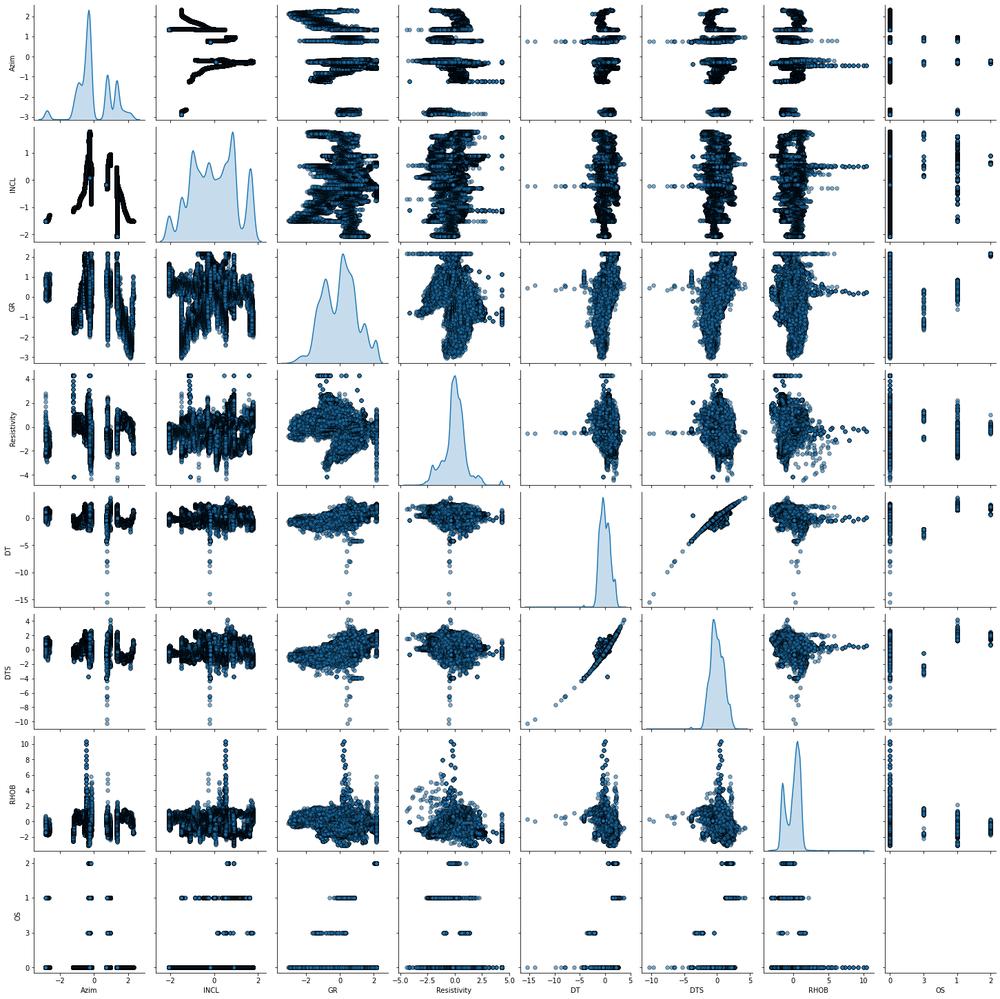

In [95]:
# After normalization
# x = well_train_norm[feature_target].astype(float)
sns.pairplot(well_train_norm, vars=feature_target, diag_kind = 'kde',
             plot_kws = {'alpha': 0.6, 's': 30, 'edgecolor': 'k'})

### b- Outliers removal

In [43]:
# make copy of well_train_norm, called well_train_dropped
well_train_drop = well_train_norm.copy()

# on the well_train_drop, drop WELL and DEPTH column
well_train_drop = well_train_norm.drop(['WELL', 'MD'], axis=1)

In [44]:
well_train_drop

,Azim,INCL,GR,Resistivity,DT,DTS,RHOB,OS
0,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119,0
1,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119,0
2,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119,0
3,-1.241782,-1.151977,-0.899020,4.282526,-0.324784,-0.594846,-1.719119,0
4,-1.241369,-1.151296,-0.939731,4.282526,0.315880,0.055573,-1.338918,0
...,...,...,...,...,...,...,...,...
46041,0.736004,-0.170948,1.254626,-0.129737,-4.205519,-3.956989,0.587579,0
46042,0.736004,-0.170948,1.300356,-0.149319,-4.205519,-3.956989,0.683043,0
46043,0.736004,-0.170948,1.242260,-0.166486,-4.205519,-3.956989,0.716722,0
46044,0.736004,-0.170948,1.087271,-0.189922,-4.205519,-3.956989,0.693121,0


In [45]:
# Method 1: Standard Deviation Method (traditional)
well_train_std = well_train_drop[np.abs(well_train_drop - well_train_drop.mean()) <= (3 * well_train_drop.std())]

## delete all rows that have NaNs
well_train_std = well_train_std.dropna()

# Method 2: Isolation Forest
iso = IsolationForest(contamination=0.5)
yhat = iso.fit_predict(well_train_drop)
mask = yhat != -1
well_train_iso = well_train_norm[mask]

# Method 3: Minimum Covariance Determinant
ee = EllipticEnvelope(contamination=0.1)
yhat = ee.fit_predict(well_train_drop)
mask = yhat != -1
well_train_ee = well_train_norm[mask]

# Method 4: Local Outlier Factor
lof = LocalOutlierFactor(contamination=0.3)
yhat = lof.fit_predict(well_train_drop)
mask = yhat != -1
well_train_lof = well_train_norm[mask]

# Method 5: One-class SVM
svm = OneClassSVM(nu=0.1)
yhat = svm.fit_predict(well_train_drop)
mask = yhat != -1
well_train_svm = well_train_norm[mask]

Number of points before outliers removed                       : 46046
Number of points after outliers removed with Standard Deviation: 43744
Number of points after outliers removed with Isolation Forest  : 23023
Number of points after outliers removed with Min. Covariance   : 41441
Number of points after outliers removed with Outlier Factor    : 32232
Number of points after outliers removed with One-class SVM     : 41433


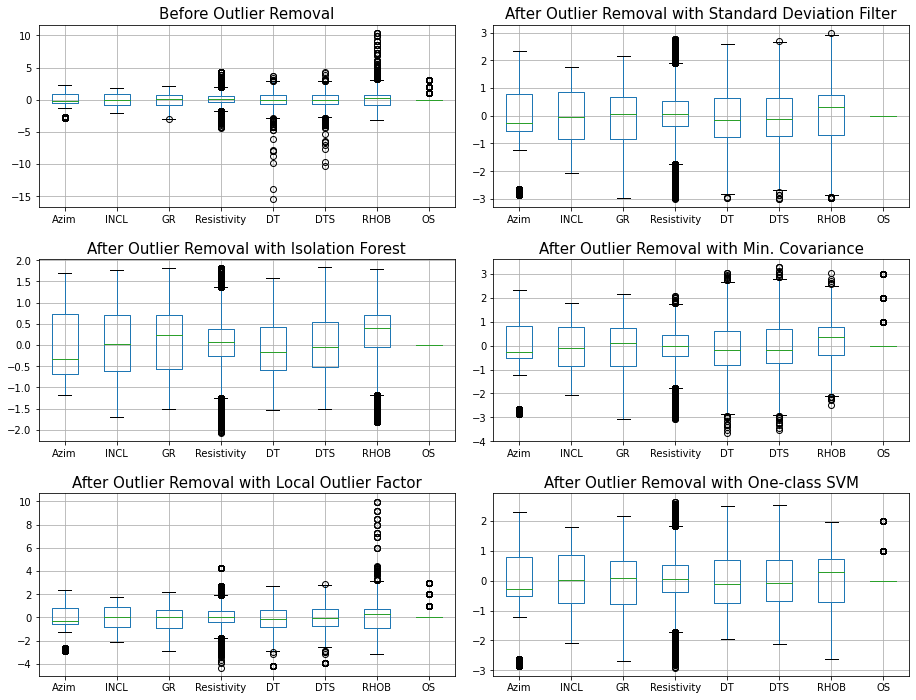

In [46]:
print('Number of points before outliers removed                       :', len(well_train_norm))
print('Number of points after outliers removed with Standard Deviation:', len(well_train_std))
print('Number of points after outliers removed with Isolation Forest  :', len(well_train_iso))
print('Number of points after outliers removed with Min. Covariance   :', len(well_train_ee))
print('Number of points after outliers removed with Outlier Factor    :', len(well_train_lof))
print('Number of points after outliers removed with One-class SVM     :', len(well_train_svm))

plt.figure(figsize=(13,10))

plt.subplot(3,2,1)
well_train_norm[feature_target].boxplot()
plt.title('Before Outlier Removal', size=15)

plt.subplot(3,2,2)
well_train_std[feature_target].boxplot()
plt.title('After Outlier Removal with Standard Deviation Filter', size=15)

plt.subplot(3,2,3)
well_train_iso[feature_target].boxplot()
plt.title('After Outlier Removal with Isolation Forest', size=15)

plt.subplot(3,2,4)
well_train_ee[feature_target].boxplot()
plt.title('After Outlier Removal with Min. Covariance', size=15)

plt.subplot(3,2,5)
well_train_lof[feature_target].boxplot()
plt.title('After Outlier Removal with Local Outlier Factor', size=15)

plt.subplot(3,2,6)
well_train_svm[feature_target].boxplot()
plt.title('After Outlier Removal with One-class SVM', size=15)

plt.tight_layout(1.7)
plt.show()

In [47]:
well_train_lof['OS'].value_counts()

0    31167
1      816
2      189
3       60
Name: OS, dtype: int64

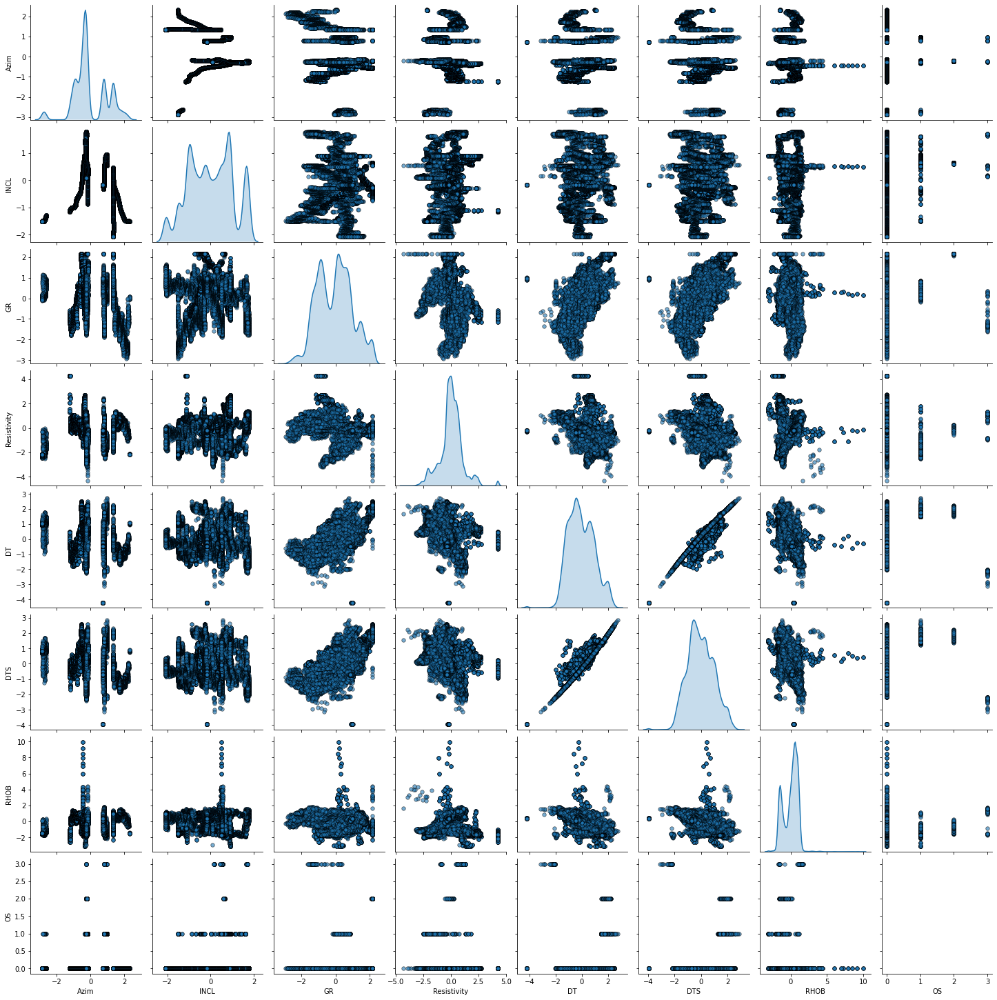

In [119]:
# After outlier removal
sns.pairplot(well_train_lof, vars=feature_target,
             diag_kind='kde',
             plot_kws = {'alpha': 0.6, 's': 30, 'edgecolor': 'k'})

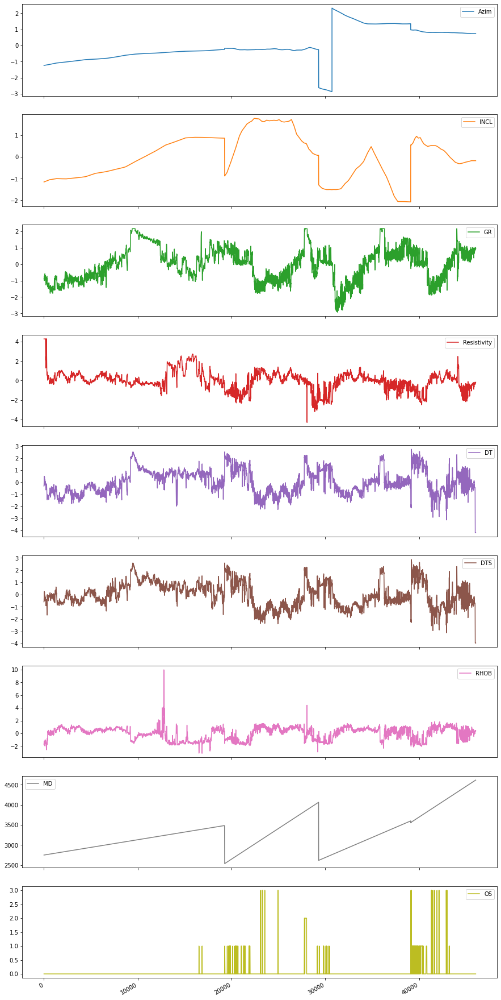

In [120]:
# plot the data (static)
well_train_lof.plot(subplots=True, figsize=(15,35))
plt.show()

In [ ]:
# Interactive plot
# Converting the columns into numpy arrays 
depth = df.index
MD = df['MD'].values 
DT = df['DT'].values 
DTS = df['DTS'].values 
RHOB = df['RHOB'].values 
Resistivity = df['Resistivity'].values 
gamma_ray = df['GR'].values 


# making 7 column and only 1 row 
fig = make_subplots(rows=1, cols=5)

# plotting the graph of Gamma ray against depth 
fig.append_trace(go.Scatter(
    x=gamma_ray,
    y=depth,
    name='Gamma-Ray',
), row=1, col=1)
# plotting the graph of shale volume against depth 
fig.append_trace(go.Scatter(
    x=Resistivity,
    y=depth,
    name='Resistivity',
), row=1, col=2)
# plotting the graph of resitivity against depth 
fig.append_trace(go.Scatter(
    x=RHOB,
    y=depth, 
    name='Bulk density', 
), row=1, col=3)
# plotting the graph of temperature against depth 
fig.append_trace(go.Scatter(
    x=DTS, 
    y=depth,
    name='Shear slowness', 
), row=1, col=4)
# plotting the graph of velocity against depth 
fig.append_trace(go.Scatter(
    x=DT, 
    y=depth,
    name='Compressional slowness', 
), row=1, col=5)


# showing the plots in a horizontal order
fig.update_layout(height=2000, width=1300, title_text="Well Log Exploratory Data Analysis")
fig.show()

<a id="top"></a>

<div class="list-group" id="list-tab" role="tablist">
<h3 class="list-group-item list-group-item-action active" data-toggle="list" style='background:#7ca4cd; border:0' role="tab" aria-controls="home"><center>Basic statistics</center></h3>

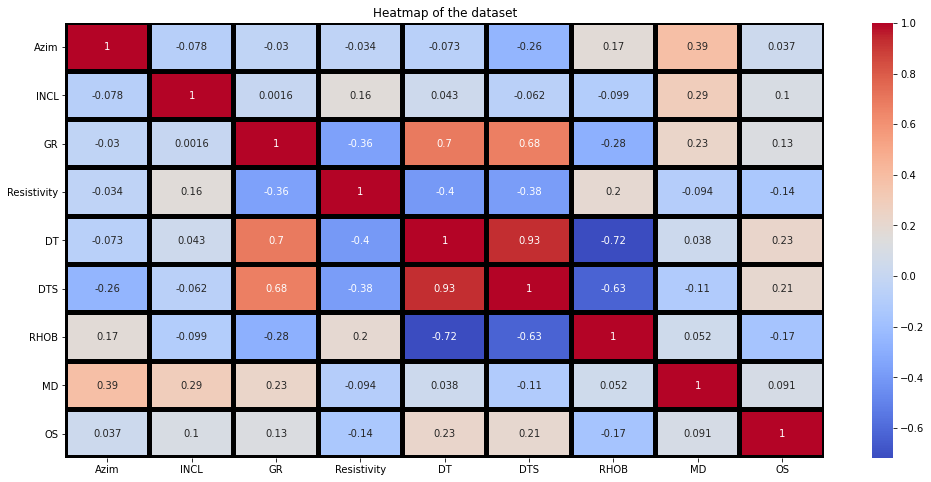

In [121]:
fig=plt.figure(figsize=(17,8))
ax = plt.axes()
sns.heatmap(well_train_lof.corr(), ax = ax, cmap='coolwarm', annot=True, linewidths=4, linecolor='black')
ax.set_title(f'''Heatmap of the dataset''')
plt.show()

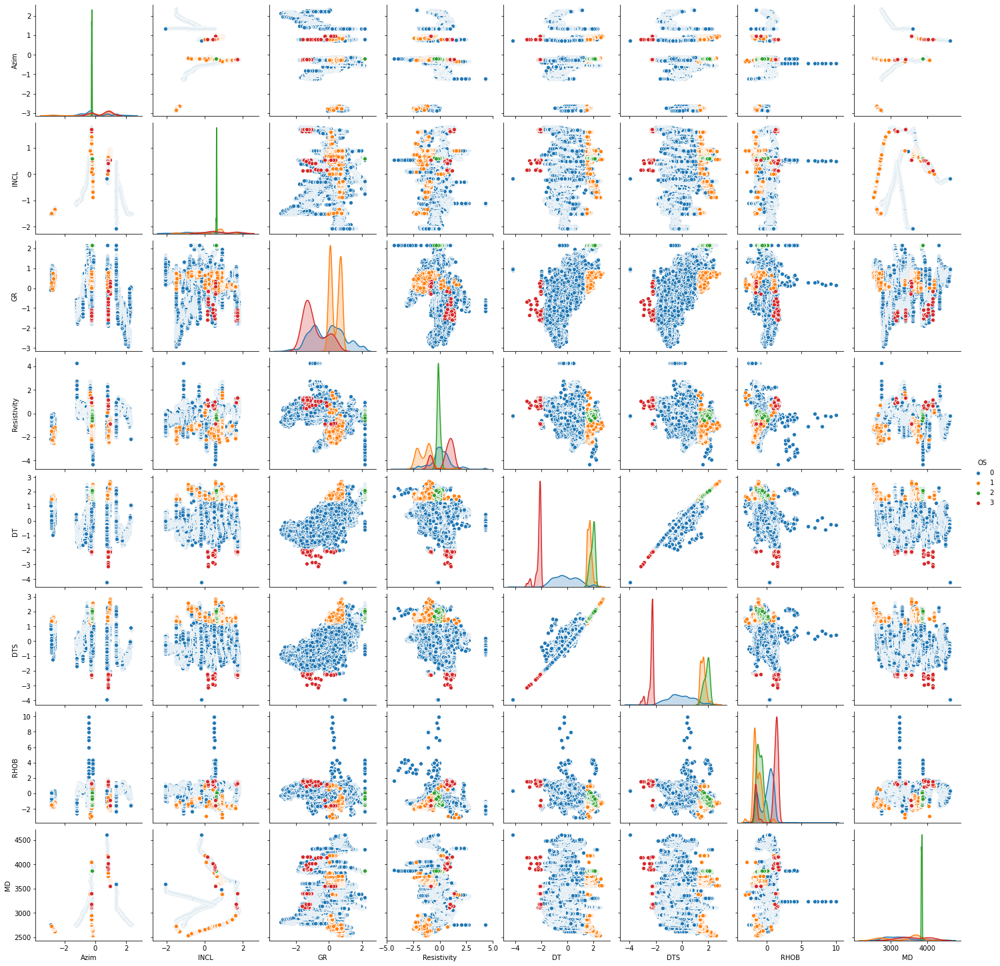

In [122]:
# An example of the various duo_relationns in the data
sns.pairplot(well_train_lof, hue='OS', kind='scatter')

In [ ]:
# Interactive visualization
#import plotly.express as px
#fig = px.scatter(df, x="Shale_Volume", y="Restivity", color="Classification")
#fig.show()

In [ ]:
# Displaying the count for non Deviated hole 
#majority_class = df.loc[df['OS'] == 0].count()[0]

# Showing the count for Deviated hole 
#minority_class = df.loc[df['OS'] == 1].count()[0]

# Printing the classes for the deviated and non-deviated class 
#print('Non Deviated Class (Classification = 0): {}'.format(majority_class))
#print('Deviated Class (Classification = 1) : {}'.format(minority_class))

#plt.figure(figsize=(9, 7))
#sns.countplot(x="Classification", data=df)
#plt.show()

In [ ]:
# Recalibrate the samples with SMOTE
# pip install imbalanced-learn
#from imblearn.over_sampling import SMOTE
#X = df.drop('Classification',axis=1).values
#y = df[['Classification']].values.ravel()
# Using SMOTE to Balance the imbalanced data 
#X_resampled, y_resampled = SMOTE().fit_resample(X, y)

# convert y_resampled to df
#df_y_resampled = pd.DataFrame(y_resampled,columns=['Classification'])

# showing a plot of the Balanced dataset 
#majority_class = df_y_resampled.loc[df_y_resampled['Classification'] == 0].count()[0]

# Showing the count for Non Hole Deviation 
#minority_class = df_y_resampled.loc[df_y_resampled['Classification'] == 1].count()[0]

# Printing the classes for the deviated and non-deviated class 
#print('Non Deviated Class (Classification = 0): {}'.format(majority_class))
#print('Deviated Class (Classification = 1) : {}'.format(minority_class))

#plt.figure(figsize=(9, 7))

#sns.countplot(x="Classification", data=df_y_resampled)
#plt.show()

# 4- Machine learning models training

In [53]:
data= well_train_lof.reset_index()
data.drop(['index'], axis=1, inplace=True)

In [55]:
feature_cols = ['Azim', 'INCL','GR', 'Resistivity', 'DT', 'DTS', 'RHOB']
target = 'OS'

#well_train_lof

### BEGIN SOLUTION
from sklearn.model_selection import StratifiedShuffleSplit

# Get the split indexes
strat_shuf_split = StratifiedShuffleSplit(n_splits=1, 
                                          test_size=0.3, 
                                          random_state=42)

train_idx, test_idx = next(strat_shuf_split.split(data[feature_cols], data.OS))

# Create the dataframes
X_train = data.loc[train_idx, feature_cols]
y_train = data.loc[train_idx, 'OS']

X_test  = data.loc[test_idx, feature_cols]
y_test  = data.loc[test_idx, 'OS']

In [56]:
y_train.value_counts(normalize=True)

0    0.966980
1    0.025308
2    0.005851
3    0.001862
Name: OS, dtype: float64

In [57]:
y_test.value_counts(normalize=True)


0    0.966908
1    0.025336
2    0.005895
3    0.001861
Name: OS, dtype: float64

The data ain't balanced so during metric assassemnt we have to take that into consideration

SVC: 99.042628 (+/- 0.191416) performed in 8.906012 seconds
KNN: 99.614391 (+/- 0.115687) performed in 0.583514 seconds
RF: 99.991137 (+/- 0.017727) performed in 8.246564 seconds
Ada: 99.410514 (+/- 0.020288) performed in 14.906183 seconds
ET: 99.911351 (+/- 0.044330) performed in 3.686937 seconds
GB: 99.991137 (+/- 0.017727) performed in 52.256493 seconds
LR: 97.987763 (+/- 0.156378) performed in 3.142602 seconds


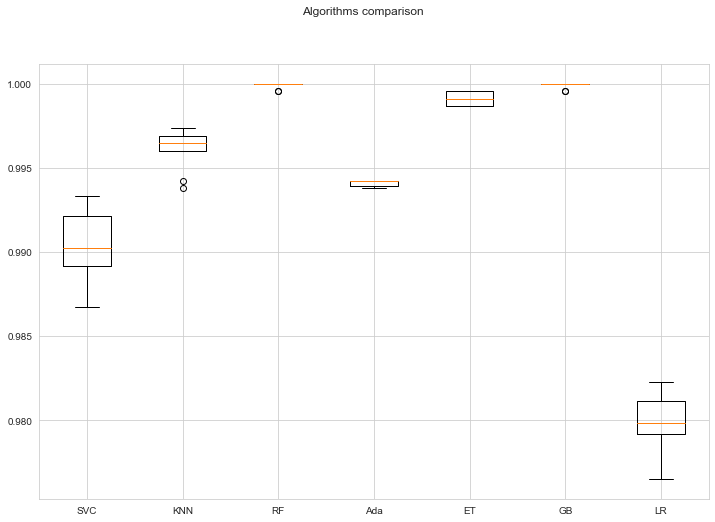

In [62]:
# Without principal component analysis
n_components = 5
pipelines = []
n_estimators = 200
seed = 42

#print(df.shape)
pipelines.append( ('SVC',
                   Pipeline([
                              #('sc', StandardScaler()),
#                               ('pca', PCA(n_components = n_components, random_state=seed ) ),
                             ('SVC', SVC(random_state=seed))]) ) )


pipelines.append(('KNN',
                  Pipeline([ 
                              #('sc', StandardScaler()),
#                             ('pca', PCA(n_components = n_components, random_state=seed ) ),
                            ('KNN', KNeighborsClassifier()) ])))
pipelines.append( ('RF',
                   Pipeline([
                              #('sc', StandardScaler()),
#                              ('pca', PCA(n_components = n_components, random_state=seed ) ), 
                             ('RF', RandomForestClassifier(random_state=seed, n_estimators=n_estimators)) ]) ))


pipelines.append( ('Ada',
                   Pipeline([ 
                              #('sc', StandardScaler()),
#                              ('pca', PCA(n_components = n_components, random_state=seed ) ), 
                    ('Ada', AdaBoostClassifier(random_state=seed,  n_estimators=n_estimators)) ]) ))

pipelines.append( ('ET',
                   Pipeline([
                              #('sc', StandardScaler()),
#                              ('pca', PCA(n_components = n_components, random_state=seed ) ), 
                             ('ET', ExtraTreesClassifier(random_state=seed, n_estimators=n_estimators)) ]) ))
pipelines.append( ('GB',
                   Pipeline([ 
                             #('sc', StandardScaler()),
#                             ('pca', PCA(n_components = n_components, random_state=seed ) ), 
                             ('GB', GradientBoostingClassifier(random_state=seed)) ]) ))

pipelines.append( ('LR',
                   Pipeline([
                              #('sc', StandardScaler()),
#                               ('pca', PCA(n_components = n_components, random_state=seed ) ), 
                             ('LR', LogisticRegression(random_state=seed)) ]) ))

results, names, times  = [], [] , []
num_folds = 10
scoring = 'accuracy'

for name, model in pipelines:
    start = time()
    kfold = StratifiedKFold(n_splits=num_folds, random_state=seed, shuffle=True)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring = scoring,
                                n_jobs=-1) 
    t_elapsed = time() - start
    results.append(cv_results)
    names.append(name)
    times.append(t_elapsed)
    msg = "%s: %f (+/- %f) performed in %f seconds" % (name, 100*cv_results.mean(), 
                                                       100*cv_results.std(), t_elapsed)
    print(msg)


fig = plt.figure(figsize=(12,8))    
fig.suptitle("Algorithms comparison")
ax = fig.add_subplot(1,1,1)
plt.boxplot(results)
ax.set_xticklabels(names)
plt.show()

In [65]:
# Create a pipeline with a Random forest classifier
pipe_rfc = Pipeline([ 
                      ('scl', StandardScaler()), 
                    ('rfc', RandomForestClassifier(random_state=seed, n_jobs=-1) )])

# Set the grid parameters
param_grid_rfc =  [ {
    'rfc__n_estimators': [100, 200,300,400], # number of estimators
    #'rfc__criterion': ['gini', 'entropy'],   # Splitting criterion
    'rfc__max_features':[0.05 , 0.1], # maximum features used at each split
    'rfc__max_depth': [None, 5], # Max depth of the trees
    'rfc__min_samples_split': [0.005, 0.01], # mininal samples in leafs
    }]
# Use 10 fold CV
kfold = StratifiedKFold(n_splits=num_folds, random_state= seed, shuffle=True)
grid_rfc = GridSearchCV(pipe_rfc, param_grid= param_grid_rfc, cv=kfold, scoring=scoring, verbose= 1, n_jobs=-1)

#Fit the pipeline
start = time()
grid_rfc = grid_rfc.fit(X_train, y_train)
end = time()

print("RFC grid search took %.3f seconds" %(end-start))

# Best score and best parameters
print('-------Best score----------')
print(grid_rfc.best_score_ * 100.0)
print('-------Best params----------')
print(grid_rfc.best_params_)

Fitting 10 folds for each of 32 candidates, totalling 320 fits
RFC grid search took 242.701 seconds
-------Best score----------
99.9689755590959
-------Best params----------
{'rfc__max_depth': None, 'rfc__max_features': 0.05, 'rfc__min_samples_split': 0.005, 'rfc__n_estimators': 300}


In [63]:
# Let's define some utility functions to plot the learning & validation curves

def plot_learning_curve(train_sizes, train_scores, test_scores, title, alpha=0.1):
    train_mean = np.mean(train_scores, axis=1)
    train_std = np.std(train_scores, axis=1)
    test_mean = np.mean(test_scores, axis=1)
    test_std = np.std(test_scores, axis=1)
    plt.plot(train_sizes, train_mean, label='train score', color='blue', marker='o')
    plt.fill_between(train_sizes,train_mean + train_std,
                    train_mean - train_std, color='blue', alpha=alpha)
    plt.plot(train_sizes, test_mean, label='test score', color='red',marker='o')
    plt.fill_between(train_sizes,test_mean + test_std, test_mean - test_std , color='red', alpha=alpha)
    plt.title(title)
    plt.xlabel('Number of training points')
    plt.ylabel('Accuracy')
    plt.grid(ls='--')
    plt.legend(loc='best')
    plt.show()    
    
def plot_validation_curve(param_range, train_scores, test_scores, title, alpha=0.1):
    train_mean = np.mean(train_scores, axis=1)
    train_std = np.std(train_scores, axis=1)
    test_mean = np.mean(test_scores, axis=1)
    test_std = np.std(test_scores, axis=1)
    plt.plot(param_range, train_mean, label='train score', color='blue', marker='o')
    plt.fill_between(param_range,train_mean + train_std,
                    train_mean - train_std, color='blue', alpha=alpha)
    plt.plot(param_range, test_mean, label='test score', color='red', marker='o')
    plt.fill_between(param_range,test_mean + test_std, test_mean - test_std , color='red', alpha=alpha)
    plt.title(title)
    plt.grid(ls='--')
    plt.xlabel('Parameter value')
    plt.ylabel('Accuracy')
    plt.legend(loc='best')
    plt.show()    

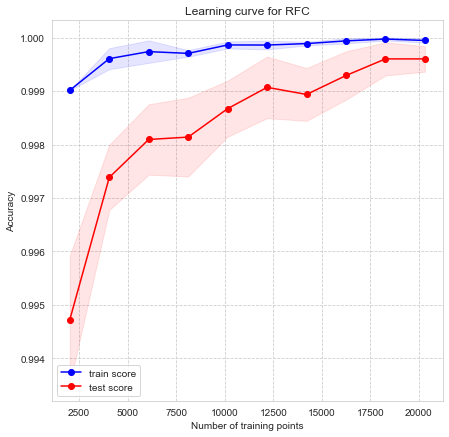

In [66]:
plt.figure(figsize=(7,7))

train_sizes, train_scores, test_scores = learning_curve(
              estimator= grid_rfc.best_estimator_ , X= X_train, y = y_train, 
                train_sizes=np.arange(0.1,1.1,0.1), cv= 10,  scoring='accuracy', n_jobs= - 1)

plot_learning_curve(train_sizes, train_scores, test_scores, title='Learning curve for RFC')

In [68]:
RF_clf=RandomForestClassifier(random_state=seed,
                              max_features= 0.05, 
                              min_samples_split= 0.005, 
                              n_estimators= 300)

RF_clf=RF_clf.fit(X_train, y_train)
y_pred=RF_clf.predict(X_test)

# final model evaluation
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

# Generate the confusion matrix and 
print('confusion matrix')
print('-'*30)
print(confusion_matrix(y_test, y_pred))
print('')
# print classification report
print('classification report')
print('-'*30)
print(classification_report(y_test, y_pred))

confusion matrix
------------------------------
[[9350    0    0    0]
 [   3  242    0    0]
 [   1    0   56    0]
 [   2    0    0   16]]

classification report
------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      9350
           1       1.00      0.99      0.99       245
           2       1.00      0.98      0.99        57
           3       1.00      0.89      0.94        18

    accuracy                           1.00      9670
   macro avg       1.00      0.96      0.98      9670
weighted avg       1.00      1.00      1.00      9670



In [69]:
from sklearn.metrics import precision_recall_fscore_support as score
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score
from sklearn.preprocessing import label_binarize

metrics = list()
cm = dict()

#for lab in coeff_labels:

# Precision, recall, f-score from the multi-class support function
precision, recall, fscore, _ = score(y_test, y_pred, average='weighted')

# The usual way to calculate accuracy
accuracy = accuracy_score(y_test, y_pred)

# ROC-AUC scores can be calculated by binarizing the data
#auc = roc_auc_score(label_binarize(y_test, classes=[0,1,2,3,4,5]),
#          label_binarize(y_pred[lab], classes=[0,1,2,3,4,5]), 
#          average='weighted')

# Last, the confusion matrix
cm = confusion_matrix(y_test, y_pred)

metrics.append(pd.Series({'precision':precision, 'recall':recall, 
                          'fscore':fscore, 'accuracy':accuracy}, name='Metrics'))
#                          'auc':auc}))
#                         name=lab))

metrics = pd.concat(metrics, axis=1)

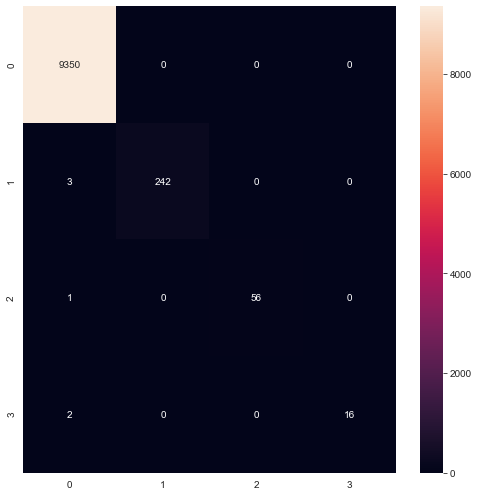

In [71]:
### BEGIN SOLUTION
#fig, axList = plt.subplots(nrows=2, ncols=2)
#axList = axList.flatten()
#fig.set_size_inches(12, 10)

#axList[-1].axis('off')

#for ax,lab in zip(axList[:-1], coeff_labels):
plt.figure(figsize=(7,7))
sns.heatmap(cm, annot=True, fmt='d');
ax.set(title='Confusion metrics');
    
plt.tight_layout()
### END SOLUTION

# 3D Visualization for the predicted problems

In [138]:
# Read the Files 
D_files=[]
Csv_file_list = []
path = "C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/"
# View contents of the path


In [140]:
import os
files = os.listdir(path)
files

['15_9-19_SR.csv',
 '15_9-F-1.csv',
 '15_9-F-10.csv',
 '15_9-F-15.csv',
 '15_9-F-4.csv']

In [141]:
# Read the Files
Csv_file_list = []

path = 'C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/'
# View contents of the path
files = os.listdir(path)
files

['15_9-19_SR.csv',
 '15_9-F-1.csv',
 '15_9-F-10.csv',
 '15_9-F-15.csv',
 '15_9-F-4.csv']

In [142]:
Csv_file_list=[]
for file in files:
    if file.lower().endswith('.csv'):
        Csv_file_list.append(path + file)
        
Csv_file_list

['C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-19_SR.csv',
 'C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-F-1.csv',
 'C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-F-10.csv',
 'C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-F-15.csv',
 'C:/Users/DELL/Desktop/Volve dump base data xml/Web_app_models/Problem forecast/Geo_log_prob_NW_data/Spec_data/15_9-F-4.csv']

In [143]:
# Create two data set one as a seperate list
# The second is a concatenated version
# Renaminig the columns    

df_list=[]
for file in Csv_file_list:
    df = pd.read_csv(file, index_col=None)
    df_list.append(df)
    
well1, well2, well3, well4, well5= df_list

In [144]:
for i in range(len(Csv_file_list)):
        print(f'''Example of the dataset {files[i][:-4]}''')
        display(df_list[i].describe())
        display(df_list[i].head())
        display(df_list[i].info())
        print('\n')

Example of the dataset 15_9-19_SR


,Unnamed: 0,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,...,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000,6948.000000
mean,26154.358664,269.615159,46.441371,4088.081060,536.721866,-2580.157010,2627.057389,0.034254,79.685748,134.745468,...,0.233393,3.948314,36.258091,1193.126724,8123.983701,7168.619357,82.263190,36.772877,0.136730,2736.057389
std,2007.270390,3.785576,5.204897,305.908007,5.605025,220.339997,210.941089,0.181895,18.283591,28.913836,...,0.012592,2.288674,5.221088,711.268619,2002.055543,1490.180413,49.040244,26.628705,0.404756,210.941089
min,22625.000000,264.760000,39.610386,3550.206800,522.789000,-2944.101000,2277.297130,0.000000,13.500100,30.078890,...,0.197889,0.646352,14.639630,25.007730,4856.279000,4694.406000,1.724223,2.766100,0.000000,2386.297130
25%,24417.750000,267.310025,41.098060,3823.421900,532.991600,-2771.849250,2442.247369,0.000000,66.360625,113.673025,...,0.222939,2.333219,32.023187,599.571450,7127.530500,6444.933500,41.339000,15.465375,0.000000,2551.247369
50%,26154.500000,268.981500,47.322250,4088.102600,538.571200,-2592.207000,2614.507581,0.000000,74.786650,126.998000,...,0.234561,3.911097,37.297775,1178.699000,8335.747500,7347.378500,81.268410,33.062450,0.000000,2723.507581
75%,27891.250000,269.711575,50.192118,4352.783300,541.221350,-2391.325000,2808.513543,0.000000,93.563075,156.691175,...,0.241499,5.018341,39.972192,1596.395000,9017.050750,7836.756500,110.067575,52.237075,0.000000,2917.513543
max,29631.000000,279.079000,55.896879,4617.921200,543.239900,-2174.982000,3009.644621,1.000000,181.813900,296.251900,...,0.373871,77.174960,66.230430,10705.170000,71194.590000,54342.590000,738.095500,304.333700,3.000000,3118.644621


,Unnamed: 0,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,22625,15/9-19_SR,278.9957,50.544762,3550.2068,523.5649,-2174.982,2277.297130,Hod,0,...,6.087025,44.12209,2438.428,9102.264,7645.988,168.1237,55.7555,0,Normal condition,2386.297130
1,22626,15/9-19_SR,278.9970,50.542680,3550.3592,523.5832,-2175.098,2277.393979,Hod,0,...,6.087025,44.12209,2438.428,9102.470,7646.194,168.1237,55.0681,0,Normal condition,2386.393979
2,22627,15/9-19_SR,278.9984,50.540597,3550.5116,523.6016,-2175.214,2277.490831,Hod,0,...,6.087025,44.12209,2438.428,9102.666,7646.390,168.1237,56.0905,0,Normal condition,2386.490831
3,22628,15/9-19_SR,278.9998,50.538515,3550.6640,523.6199,-2175.331,2277.587688,Hod,0,...,6.087025,44.12209,2438.428,9102.861,7646.586,168.1237,58.8310,0,Normal condition,2386.587688
4,22629,15/9-19_SR,279.0012,50.536432,3550.8164,523.6383,-2175.447,2277.684550,Hod,0,...,6.087025,44.12209,2438.428,9103.058,7646.782,168.1237,60.3862,0,Normal condition,2386.684550


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6948 entries, 0 to 6947
Data columns (total 27 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0     6948 non-null   int64  
 1   wellName       6948 non-null   object 
 2   Azim           6948 non-null   float64
 3   INCL           6948 non-null   float64
 4   DEPT           6948 non-null   float64
 5   S              6948 non-null   float64
 6   W              6948 non-null   float64
 7   TVDSS          6948 non-null   float64
 8   Zone Name      6948 non-null   object 
 9   MECH_LITHO     6948 non-null   int64  
 10  DT             6948 non-null   float64
 11  DTS            6948 non-null   float64
 12  RHOB           6948 non-null   float64
 13  Resistivity    6948 non-null   float64
 14  PPRS_HP_D      6948 non-null   float64
 15  SVERTICAL_EXT  6948 non-null   float64
 16  PR_STA         6948 non-null   float64
 17  YME_STA        6948 non-null   float64
 18  FANG    

None



Example of the dataset 15_9-F-1


,Unnamed: 0,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,...,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000,9822.000000
mean,29619.500000,270.105718,31.424479,3107.850000,749.582655,77.682077,2774.040345,0.130116,77.410579,131.147496,...,0.233796,26.716890,36.720082,1174.805576,8551.998665,7925.080746,80.999992,48.624734,0.005600,2883.040345
std,2835.511506,106.735326,8.117424,283.551151,105.454531,110.060314,232.093847,0.336448,13.054261,20.644126,...,0.008273,7.965001,3.664768,432.883896,1158.270252,1006.832633,29.846294,66.332481,0.074625,232.093847
min,24709.000000,0.013920,20.880032,2616.800000,551.149700,-113.215000,2359.649452,0.000000,50.178200,88.081960,...,0.209282,7.267616,23.955320,168.851200,5690.522000,5424.393000,11.641880,1.239300,0.000000,2468.649452
25%,27164.250000,301.587425,26.404176,2862.325000,658.030875,-32.328910,2578.940673,0.000000,69.102175,118.008525,...,0.230303,23.024217,35.494960,946.918075,8275.133250,7669.212250,65.287702,11.147825,0.000000,2687.940673
50%,29619.500000,302.803650,28.599315,3107.850000,762.216000,105.308850,2781.174842,0.000000,74.336250,126.285750,...,0.234899,27.297175,37.435310,1197.966000,8937.527000,8283.148000,82.596870,34.511900,0.000000,2890.174842
75%,32074.750000,318.329800,37.748845,3353.375000,847.932175,188.379350,2963.655366,0.000000,80.868700,136.616150,...,0.239091,31.447240,39.077653,1446.362750,9318.445750,8607.644250,99.723225,53.705750,0.000000,3072.655366
max,34530.000000,359.989100,49.493647,3598.900000,899.431000,200.296000,3189.449781,1.000000,128.763000,212.356700,...,0.259774,56.704940,45.831080,2858.552000,11487.400000,10181.710000,197.090200,873.719400,1.000000,3298.449781


,Unnamed: 0,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,24709,15/9-F-1,27.08669,28.661639,2616.8,551.1497,183.4050,2359.649452,Lista,1,...,14.97298,30.43601,478.5413,6046.584,5690.548,32.99426,79.8456,0,Normal condition,2468.649452
1,24710,15/9-F-1,27.06662,28.657846,2616.9,551.1922,183.4265,2359.737202,Lista,1,...,14.95685,30.41022,476.7479,6044.753,5689.086,32.87061,79.6564,0,Normal condition,2468.737202
2,24711,15/9-F-1,27.04655,28.650272,2617.0,551.2347,183.4479,2359.824955,Lista,1,...,14.74590,30.36256,473.4486,6022.229,5671.553,32.64313,78.1091,0,Normal condition,2468.824955
3,24712,15/9-F-1,27.02647,28.646488,2617.1,551.2772,183.4693,2359.912713,Lista,1,...,14.45612,30.32069,470.5650,5991.516,5647.710,32.44432,76.7843,0,Normal condition,2468.912713
4,24713,15/9-F-1,27.00640,28.642704,2617.2,551.3198,183.4907,2360.000475,Lista,0,...,14.22011,30.30006,469.1492,5966.701,5628.497,32.34670,73.6875,0,Normal condition,2469.000475


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9822 entries, 0 to 9821
Data columns (total 27 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0     9822 non-null   int64  
 1   wellName       9822 non-null   object 
 2   Azim           9822 non-null   float64
 3   INCL           9822 non-null   float64
 4   DEPT           9822 non-null   float64
 5   S              9822 non-null   float64
 6   W              9822 non-null   float64
 7   TVDSS          9822 non-null   float64
 8   Zone Name      9822 non-null   object 
 9   MECH_LITHO     9822 non-null   int64  
 10  DT             9822 non-null   float64
 11  DTS            9822 non-null   float64
 12  RHOB           9822 non-null   float64
 13  Resistivity    9822 non-null   float64
 14  PPRS_HP_D      9822 non-null   float64
 15  SVERTICAL_EXT  9822 non-null   float64
 16  PR_STA         9822 non-null   float64
 17  YME_STA        9822 non-null   float64
 18  FANG    

None



Example of the dataset 15_9-F-10


,Unnamed: 0,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,3070.000000,3070.00000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,...,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000,3070.000000
mean,1534.500000,130.81789,58.054494,5083.987800,-1892.487962,2787.548333,2730.608404,0.443974,75.066707,127.440873,...,0.234607,26.922198,37.257297,1190.351239,8978.018558,7713.659192,82.071830,75.727235,0.066450,2839.608404
std,886.376989,0.99784,5.930928,135.083853,73.970410,84.753012,74.361370,0.496932,5.700864,9.015396,...,0.004077,4.827647,1.701884,226.100060,547.709836,395.261441,15.589052,75.652717,0.358504,74.361370
min,0.000000,129.21000,54.140919,4850.130000,-2018.729000,2633.484000,2617.211002,0.000000,60.445170,104.318200,...,0.223810,15.308870,32.459950,636.754900,7733.532000,6815.628000,43.902700,4.015600,0.000000,2726.211002
25%,767.250000,130.13000,54.509736,4967.058900,-1956.717500,2716.568500,2661.790586,0.000000,71.234210,121.380100,...,0.232059,23.670572,36.254795,1039.988000,8602.392750,7420.573750,71.704660,19.241175,0.000000,2770.790586
50%,1534.500000,130.93445,54.610002,5083.987800,-1893.160500,2789.270500,2727.736756,0.000000,73.098930,124.329000,...,0.235845,28.191130,37.816160,1252.534000,8862.235000,7562.957500,86.359200,45.517850,0.000000,2836.736756
75%,2301.750000,131.71925,59.926792,5200.916700,-1829.346500,2860.275500,2795.521697,1.000000,78.264477,132.497850,...,0.237322,30.077520,38.398640,1339.503000,9345.326500,8029.109250,92.355480,122.322500,0.000000,2904.521697
max,3069.000000,132.53000,74.356052,5317.845600,-1761.012000,2932.375000,2863.486515,1.000000,91.891690,154.048100,...,0.247283,44.717480,41.991170,1975.268000,11678.540000,9598.588000,136.190000,813.930700,2.000000,2972.486515


,Unnamed: 0,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,0,15/9-F-10,129.4500,74.356052,4850.1300,-1761.012,2633.484,2617.211002,Hod,0,...,29.10843,38.10390,1294.960,8665.131,7299.476,89.28437,9.7900,0,Normal condition,2726.211002
1,1,15/9-F-10,129.4483,74.341567,4850.2824,-1761.106,2633.598,2617.252117,Hod,0,...,27.71667,37.66382,1230.492,8490.137,7188.614,84.83945,11.2587,0,Normal condition,2726.252117
2,2,15/9-F-10,129.4467,74.327081,4850.4348,-1761.200,2633.712,2617.293268,Hod,0,...,27.37493,37.55256,1214.575,8447.243,7161.481,83.74198,9.9104,0,Normal condition,2726.293268
3,3,15/9-F-10,129.4450,74.312596,4850.5872,-1761.294,2633.826,2617.334457,Hod,0,...,30.51650,38.52918,1359.584,8842.598,7412.140,93.74003,8.6531,0,Normal condition,2726.334457
4,4,15/9-F-10,129.4433,74.298110,4850.7396,-1761.388,2633.940,2617.375683,Hod,0,...,29.10843,38.10390,1294.960,8665.481,7299.827,89.28437,7.3100,0,Normal condition,2726.375683


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3070 entries, 0 to 3069
Data columns (total 27 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0     3070 non-null   int64  
 1   wellName       3070 non-null   object 
 2   Azim           3070 non-null   float64
 3   INCL           3070 non-null   float64
 4   DEPT           3070 non-null   float64
 5   S              3070 non-null   float64
 6   W              3070 non-null   float64
 7   TVDSS          3070 non-null   float64
 8   Zone Name      3070 non-null   object 
 9   MECH_LITHO     3070 non-null   int64  
 10  DT             3070 non-null   float64
 11  DTS            3070 non-null   float64
 12  RHOB           3070 non-null   float64
 13  Resistivity    3070 non-null   float64
 14  PPRS_HP_D      3070 non-null   float64
 15  SVERTICAL_EXT  3070 non-null   float64
 16  PR_STA         3070 non-null   float64
 17  YME_STA        3070 non-null   float64
 18  FANG    

None



Example of the dataset 15_9-F-15


,Unnamed: 0,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,...,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000,10016.000000
mean,21648.500000,203.074932,57.918659,3299.231400,-1196.722175,-688.069799,2606.408163,0.099042,78.810933,133.362027,...,0.233864,27.395527,36.498379,1215.267993,8527.846505,7244.647265,83.789777,40.008698,0.108427,2715.408163
std,2891.514482,2.687153,9.853125,440.666807,357.595854,147.478738,204.897799,0.298733,18.015995,28.490657,...,0.011647,11.465139,5.087206,620.203830,1604.934976,1104.909518,42.761548,57.309404,0.400978,204.897799
min,16641.000000,197.670000,33.045316,2536.088400,-1786.743000,-936.876500,2206.463116,0.000000,52.269000,91.388370,...,0.208258,6.915116,23.236500,148.463500,5245.417000,4863.423000,10.236200,4.405700,0.000000,2315.463116
25%,19144.750000,201.201200,50.346348,2917.659900,-1519.617250,-819.913375,2449.737307,0.000000,64.063775,110.040750,...,0.224752,17.116335,32.924285,678.231050,6978.068000,6223.159250,46.762390,12.573675,0.000000,2558.737307
50%,21648.500000,202.421700,63.576720,3299.231400,-1198.390500,-688.568700,2603.075098,0.000000,73.096700,124.325500,...,0.235847,27.946540,37.816845,1252.635000,8837.477500,7544.484000,86.366140,27.543100,0.000000,2712.075098
75%,24152.250000,204.870700,66.116298,3680.802900,-875.364300,-555.737275,2760.473184,0.000000,90.138825,151.276025,...,0.243643,36.816960,40.741147,1734.006000,9804.621000,8090.230250,119.555550,46.741525,0.000000,2869.473184
max,26656.000000,210.480000,67.689538,4062.374400,-613.438500,-441.841500,3004.251692,1.000000,132.337400,218.009300,...,0.256926,55.362170,45.010240,2651.290000,12376.950000,9830.497000,182.800000,1068.505000,3.000000,3113.251692


,Unnamed: 0,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,16641,15/9-F-15,207.3105,33.045316,2536.0884,-613.4385,-441.8415,2206.463116,Skade,0,...,8.188940,23.64143,159.6805,5269.317,4876.308,11.00958,45.8342,1,Lost circulation,2315.463116
1,16642,15/9-F-15,207.3084,33.052272,2536.2408,-613.5140,-441.8801,2206.590858,Skade,0,...,8.191495,23.64143,159.6805,5269.868,4876.736,11.00958,46.7654,1,Lost circulation,2315.590858
2,16643,15/9-F-15,207.3063,33.059228,2536.3932,-613.5894,-441.9186,2206.718591,Skade,0,...,8.209019,23.64143,159.6805,5272.150,4878.177,11.00958,46.5333,1,Lost circulation,2315.718591
3,16644,15/9-F-15,207.3042,33.066184,2536.5456,-613.6648,-441.9572,2206.846313,Skade,0,...,8.206098,23.64143,159.6805,5272.067,4878.234,11.00958,44.5765,1,Lost circulation,2315.846313
4,16645,15/9-F-15,207.3020,33.073140,2536.6980,-613.7402,-441.9958,2206.974026,Skade,0,...,8.280208,23.64143,159.6805,5280.894,4883.504,11.00958,45.8534,1,Lost circulation,2315.974026


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10016 entries, 0 to 10015
Data columns (total 27 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0     10016 non-null  int64  
 1   wellName       10016 non-null  object 
 2   Azim           10016 non-null  float64
 3   INCL           10016 non-null  float64
 4   DEPT           10016 non-null  float64
 5   S              10016 non-null  float64
 6   W              10016 non-null  float64
 7   TVDSS          10016 non-null  float64
 8   Zone Name      10016 non-null  object 
 9   MECH_LITHO     10016 non-null  int64  
 10  DT             10016 non-null  float64
 11  DTS            10016 non-null  float64
 12  RHOB           10016 non-null  float64
 13  Resistivity    10016 non-null  float64
 14  PPRS_HP_D      10016 non-null  float64
 15  SVERTICAL_EXT  10016 non-null  float64
 16  PR_STA         10016 non-null  float64
 17  YME_STA        10016 non-null  float64
 18  FANG  

None



Example of the dataset 15_9-F-4


,Unnamed: 0,Azim,INCL,DEPT,S,W,TVDSS,MECH_LITHO,DT,DTS,...,PR_STA,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,TVD
count,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,...,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000,19260.000000
mean,76557.500000,176.589119,42.577550,3117.037200,-606.899602,654.226888,2733.297066,0.190031,78.140018,144.542080,...,0.291176,22.315547,36.520448,1157.363484,9109.222818,8361.246510,79.797402,45.622633,0.002700,2842.297066
std,5560.027428,18.929383,9.328957,211.837041,137.221150,19.556138,155.624650,0.392336,13.414504,18.606224,...,0.063729,7.267914,3.836893,482.594851,808.865191,676.608719,33.273743,48.102645,0.072008,155.624650
min,66928.000000,135.494200,30.067902,2750.210400,-866.585700,612.243400,2443.884854,0.000000,53.358000,74.386700,...,0.057748,7.441253,23.552200,157.150100,-6774.975000,-9395.920000,10.835120,5.374700,0.000000,2552.884854
25%,71742.750000,161.184200,33.335540,2933.547600,-723.769000,638.612000,2599.672964,0.000000,67.192200,130.156700,...,0.242241,17.186520,33.745560,756.685000,8660.216000,8022.556000,52.171590,13.956300,0.000000,2708.672964
50%,76557.500000,182.940400,40.508857,3117.037200,-590.920300,658.631100,2747.455791,0.000000,76.447200,142.649000,...,0.309374,21.472310,36.795640,1110.301000,9045.148000,8339.477000,76.552570,27.989100,0.000000,2856.455791
75%,81372.250000,193.896700,53.449512,3300.526800,-484.624000,672.191900,2871.603132,0.000000,87.098300,156.368300,...,0.327651,27.406500,39.698240,1549.313000,9650.935000,8764.921000,106.821300,54.701500,0.000000,2980.603132
max,86187.000000,202.646000,55.229906,3483.864000,-401.453600,677.744900,2977.049504,1.000000,130.757900,215.511400,...,3.264716,256.889100,44.591080,2549.360000,12322.770000,11282.690000,175.772200,469.738000,3.000000,3086.049504


,Unnamed: 0,wellName,Azim,INCL,DEPT,S,W,TVDSS,Zone Name,MECH_LITHO,...,YME_STA,FANG,TSTR,SHMAX_PHS,SHMIN_PHS,UCS,GR,OS,OS_cat,TVD
0,66928,15/9-F-4,135.4942,30.067902,2750.2104,-401.4536,612.3137,2443.884854,Vale,0,...,24.75178,38.18847,1307.629,7885.207,7014.415,90.15782,12.3721,0,Normal condition,2552.884854
1,66929,15/9-F-4,135.4942,30.067902,2750.2104,-401.4536,612.3137,2443.884854,Vale,0,...,24.75178,38.18847,1307.629,7885.207,7014.415,90.15782,12.3721,0,Normal condition,2552.884854
2,66930,15/9-F-4,135.4942,30.067902,2750.2104,-401.4536,612.3137,2443.884854,Vale,0,...,24.75178,38.18847,1307.629,7885.207,7014.415,90.15782,12.3721,0,Normal condition,2552.884854
3,66931,15/9-F-4,135.4942,30.067902,2750.2104,-401.4536,612.3137,2443.884854,Vale,0,...,24.75178,38.18847,1307.629,7885.207,7014.415,90.15782,12.3721,0,Normal condition,2552.884854
4,66932,15/9-F-4,135.5232,30.075198,2750.3628,-401.5099,612.3664,2444.016741,Vale,0,...,20.61230,35.48936,946.257,7326.968,6597.979,65.24212,11.9165,0,Normal condition,2553.016741


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19260 entries, 0 to 19259
Data columns (total 27 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0     19260 non-null  int64  
 1   wellName       19260 non-null  object 
 2   Azim           19260 non-null  float64
 3   INCL           19260 non-null  float64
 4   DEPT           19260 non-null  float64
 5   S              19260 non-null  float64
 6   W              19260 non-null  float64
 7   TVDSS          19260 non-null  float64
 8   Zone Name      19260 non-null  object 
 9   MECH_LITHO     19260 non-null  int64  
 10  DT             19260 non-null  float64
 11  DTS            19260 non-null  float64
 12  RHOB           19260 non-null  float64
 13  Resistivity    19260 non-null  float64
 14  PPRS_HP_D      19260 non-null  float64
 15  SVERTICAL_EXT  19260 non-null  float64
 16  PR_STA         19260 non-null  float64
 17  YME_STA        19260 non-null  float64
 18  FANG  

None

In [145]:
well1.columns

Index(['Unnamed: 0', 'wellName', 'Azim', 'INCL', 'DEPT', 'S', 'W', 'TVDSS',
       'Zone Name', 'MECH_LITHO', 'DT', 'DTS', 'RHOB', 'Resistivity',
       'PPRS_HP_D', 'SVERTICAL_EXT', 'PR_STA', 'YME_STA', 'FANG', 'TSTR',
       'SHMAX_PHS', 'SHMIN_PHS', 'UCS', 'GR', 'OS', 'OS_cat', 'TVD'],
      dtype='object')

# 3D for the App

In [ ]:
df_well_path=well4


In [147]:
# Interactive well path visualization
# Define df format

#function to create wellpath plot
def well_problem_plot(df):
    x=df['S'].max()-df['S'].min()
    y=df['W'].max()-df['W'].min()
    z=df['TVD'].max()-df['TVD'].min()
    
    trace0 = go.Scatter3d(
        x=df['S'],
        y=df['W'],
        z=df['TVD'],
        mode='lines',
        line=dict(
            color='rgb(211,211,211)',
            width=20
        ),
        hoverinfo='none',
        showlegend=False
    )
    
# Deviding the different plots accordingly to the severity of the dogleg
# There are 6 sections 

    trace1 = go.Scatter3d(
        x=df[df['OS']==0]['S'],
        y=df[df['OS']==0]['W'],
        z=df[df['OS']==0]['TVD'],
        mode='markers',
        marker=dict(
            color='rgb(255, 174, 143)',
            size=5
        ),
        name='Normal condition',
        text = [
                "<b>TVD:</b> {} m<br>"
                "<b>MD:</b> {} m<br>"
                "<b>Inclination:</b> {} °<br>"
                "<b>Azimuth:</b> {} °<br>"

                "<b>UCS:</b> {} MPa<br>"
                "<b>SH_MAX:</b> {} psi<br>"
                "<b>SH_MIN:</b> {} psi<br>"
                "<b>Static Poissons ratio:</b> {} <br>"
                "<b>Static Young modulus:</b> {} Mpsi<br>"
                "<b>Pore pressure:</b> {} psi<br>"
                "<b>Vertical stress:</b> {} psi<br>"
            
                .format(
                        df['TVD'].loc[i],
                        df['DEPT'].loc[i],
                        df['INCL'].loc[i],
                        df['Azim'].loc[i],

                        df['UCS'].loc[i],
                        df['DEPT'].loc[i],
                        df['SHMAX_PHS'].loc[i],
                        df['SHMIN_PHS'].loc[i],
                        df['PR_STA'].loc[i],
                        df['YME_STA'].loc[i],
                        df['PPRS_HP_D'].loc[i],
                        df['SVERTICAL_EXT'].loc[i])
            
                for i in df[df['OS']==0].index],
        hoverinfo='text'
    )

    trace2 = go.Scatter3d(
        x=df[df['OS']==1]['S'],
        y=df[df['OS']==1]['W'],
        z=df[df['OS']==1]['TVD'],
        mode='markers',
        marker=dict(
            color='rgb(255, 103, 125)',
            size=5
        ),
        name='Lost circulation',
        text = [
                "<b>TVD:</b> {} m<br>"
                "<b>MD:</b> {} m<br>"
                "<b>Inclination:</b> {} °<br>"
                "<b>Azimuth:</b> {} °<br>"

                "<b>UCS:</b> {} MPa<br>"
                "<b>SH_MAX:</b> {} psi<br>"
                "<b>SH_MIN:</b> {} psi<br>"
                "<b>Static Poissons ratio:</b> {} <br>"
                "<b>Static Young modulus:</b> {} Mpsi<br>"
                "<b>Pore pressure:</b> {} psi<br>"
                "<b>Vertical stress:</b> {} psi<br>"
            
                .format(
                        df['TVD'].loc[i],
                        df['DEPT'].loc[i],
                        df['INCL'].loc[i],
                        df['Azim'].loc[i],

                        df['UCS'].loc[i],
                        df['DEPT'].loc[i],
                        df['SHMAX_PHS'].loc[i],
                        df['SHMIN_PHS'].loc[i],
                        df['PR_STA'].loc[i],
                        df['YME_STA'].loc[i],
                        df['PPRS_HP_D'].loc[i],
                        df['SVERTICAL_EXT'].loc[i])
            
                for i in df[df['OS']==1].index],
        hoverinfo='text'
    )

    trace3 = go.Scatter3d(
        x=df[df['OS']==2]['S'],
        y=df[df['OS']==2]['W'],
        z=df[df['OS']==2]['TVD'],
        mode='markers',
        marker=dict(
            color='rgb(111, 90, 126)',
            size=5
        ),
        name='Stuck Bottom Hole Assembley',
        text = [
                "<b>TVD:</b> {} m<br>"
                "<b>MD:</b> {} m<br>"
                "<b>Inclination:</b> {} °<br>"
                "<b>Azimuth:</b> {} °<br>"

                "<b>UCS:</b> {} MPa<br>"
                "<b>SH_MAX:</b> {} psi<br>"
                "<b>SH_MIN:</b> {} psi<br>"
                "<b>Static Poissons ratio:</b> {} <br>"
                "<b>Static Young modulus:</b> {} Mpsi<br>"
                "<b>Pore pressure:</b> {} psi<br>"
                "<b>Vertical stress:</b> {} psi<br>"
            
                .format(
                        df['TVD'].loc[i],
                        df['DEPT'].loc[i],
                        df['INCL'].loc[i],
                        df['Azim'].loc[i],

                        df['UCS'].loc[i],
                        df['DEPT'].loc[i],
                        df['SHMAX_PHS'].loc[i],
                        df['SHMIN_PHS'].loc[i],
                        df['PR_STA'].loc[i],
                        df['YME_STA'].loc[i],
                        df['PPRS_HP_D'].loc[i],
                        df['SVERTICAL_EXT'].loc[i])
            
                for i in df[df['OS']==2].index],
        hoverinfo='text'
    )

    trace4 = go.Scatter3d(
        x=df[df['OS']==3]['S'],
        y=df[df['OS']==3]['W'],
        z=df[df['OS']==3]['TVD'],
        mode='markers',
        marker=dict(
            color='rgb(206, 18, 18)',
            size=5
        ),
        name='Equipement failure',
        text = [
                "<b>TVD:</b> {} m<br>"
                "<b>MD:</b> {} m<br>"
                "<b>Inclination:</b> {} °<br>"
                "<b>Azimuth:</b> {} °<br>"

                "<b>UCS:</b> {} MPa<br>"
                "<b>SH_MAX:</b> {} psi<br>"
                "<b>SH_MIN:</b> {} psi<br>"
                "<b>Static Poissons ratio:</b> {} <br>"
                "<b>Static Young modulus:</b> {} Mpsi<br>"
                "<b>Pore pressure:</b> {} psi<br>"
                "<b>Vertical stress:</b> {} psi<br>"
            
                .format(
                        df['TVD'].loc[i],
                        df['DEPT'].loc[i],
                        df['INCL'].loc[i],
                        df['Azim'].loc[i],

                        df['UCS'].loc[i],
                        df['DEPT'].loc[i],
                        df['SHMAX_PHS'].loc[i],
                        df['SHMIN_PHS'].loc[i],
                        df['PR_STA'].loc[i],
                        df['YME_STA'].loc[i],
                        df['PPRS_HP_D'].loc[i],
                        df['SVERTICAL_EXT'].loc[i])
            
                for i in df[df['OS']==3].index],
        hoverinfo='text'
    )
 
    data = [trace0,trace1,trace2,trace3,trace4]

    layout = dict(
        width=900,
        height=800,
        margin=dict(t=0,b=0, pad=0),
        autosize=False,
        legend=dict(x=1,y=0.85),
        hoverlabel=dict(
                        bgcolor='rgb(255,255,255)',
                        bordercolor='rgb(0,0,0)'
                        ),
        hovermode='closest',
        scene=dict(
            xaxis=dict(
                title='<b>Northing (m)</b>',
                gridcolor='rgb(169,169,169)',
                zerolinecolor='rgb(169,169,169)',
                showbackground=True,
                backgroundcolor='rgb(200, 200, 230)',
                showspikes=False
            ),
            yaxis=dict(
                title='<b>Easting (m)</b>',
                gridcolor='rgb(169,169,169)',
                zerolinecolor='rgb(169,169,169)',
                showbackground=True,
                backgroundcolor='rgb(230, 200,230)',
                showspikes=False
            ),
            zaxis=dict(
                title='<b>Depth (m)</b>',
                gridcolor='rgb(169,169,169)',
                zerolinecolor='rgb(169,169,169)',
                showbackground=True,
                backgroundcolor='rgb(230, 230,200)',
                showspikes=False,
                autorange='reversed'
            ),
            camera=dict(
                up=dict(
                    x=0,
                    y=0,
                    z=1
                ),
                eye=dict(
                    x=-1.25,
                    y=1.25,
                    z=0.5,
                )
            ),
            aspectratio = dict(x=x/z, y=y/z, z=1),
            aspectmode = 'manual'
        )
    )
    
    
    
    
    figure = dict(data=data, layout=layout)
    fig=go.Figure(data,layout)
    return fig.show()


display(well_problem_plot(df_well_path))

None

# 5- Saving the machine learning model

In [ ]:
# save the model to disk
filename = 'Drilling_problems_forecast.pkl'
pickle.dump(model, open(filename, 'wb'))

# 6- Deep learning comparaison

In [76]:
# Building An MLP 
model = Sequential() 
model.add(Dense(32, input_dim = X_train.shape[1], activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(5, activation = 'relu'))
model.add(Dense(1, activation = 'sigmoid'))
model.compile(loss = 'binary_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

# Model summary 
model.summary() 

Model: "sequential_66"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_264 (Dense)            (None, 32)                256       
_________________________________________________________________
dense_265 (Dense)            (None, 8)                 264       
_________________________________________________________________
dense_266 (Dense)            (None, 5)                 45        
_________________________________________________________________
dense_267 (Dense)            (None, 1)                 6         
Total params: 571
Trainable params: 571
Non-trainable params: 0
_________________________________________________________________


In [78]:
# Best: 0.9585470080375671 using {'batch_size': 5, 'unit1': 50, 'unit2': 40, 'unit3': 10}

# Training the model 
hist = model.fit(X_train, y_train, epochs = 10, batch_size = 4, validation_data = (X_test, y_test))

Epoch 1/10
5641/5641 [==============================] - 6s 1ms/step - loss: -0.0648 - accuracy: 0.9715 - val_loss: -0.2376 - val_accuracy: 0.9740
Epoch 2/10
5641/5641 [==============================] - 7s 1ms/step - loss: -0.4909 - accuracy: 0.9699 - val_loss: -0.9748 - val_accuracy: 0.9716
Epoch 3/10
5641/5641 [==============================] - 7s 1ms/step - loss: -1.6425 - accuracy: 0.9673 - val_loss: -2.6772 - val_accuracy: 0.9654
Epoch 4/10
5641/5641 [==============================] - 9s 2ms/step - loss: -3.9255 - accuracy: 0.9618 - val_loss: -5.7307 - val_accuracy: 0.9569
Epoch 5/10
5641/5641 [==============================] - 8s 1ms/step - loss: -8.1858 - accuracy: 0.9617 - val_loss: -11.6789 - val_accuracy: 0.9645
Epoch 6/10
5641/5641 [==============================] - 9s 2ms/step - loss: -15.2816 - accuracy: 0.9615 - val_loss: -20.0568 - val_accuracy: 0.9648
Epoch 7/10
5641/5641 [==============================] - 9s 2ms/step - loss: -26.1202 - accuracy: 0.9619 - val_loss: -35.4

In [79]:
# Evaulating the model accuracy  
accuracy = model.evaluate(X_test, y_test)[1] * 100 
accuracy = str(accuracy)[:5]
!echo 
print('The model is {}% Accurate.'.format(accuracy))

303/303 [==============================] - 0s 1ms/step - loss: -121.0314 - accuracy: 0.9613
ECHO is on.
The model is 96.13% Accurate.


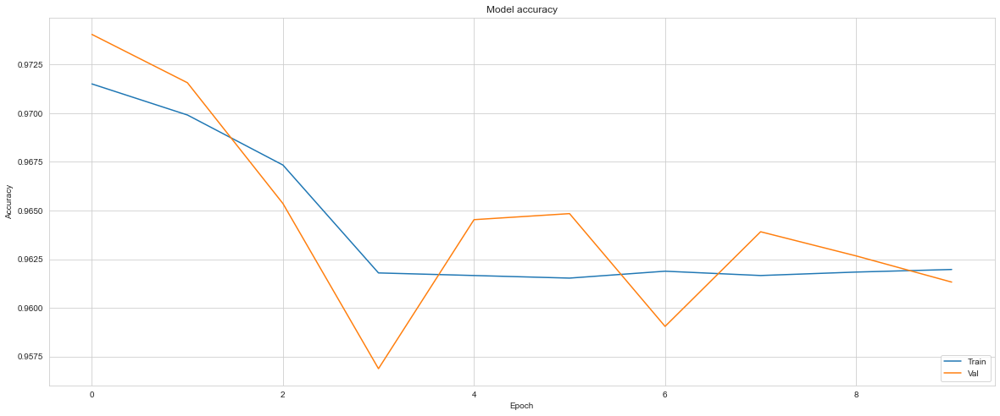

In [80]:
# showing a plot of how Accurate the model is against the 
# test dataset
plt.figure(figsize=(20, 8))
plt.grid(True)
plt.plot(hist.history['accuracy'])
plt.plot(hist.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val'], loc='lower right')
plt.show()

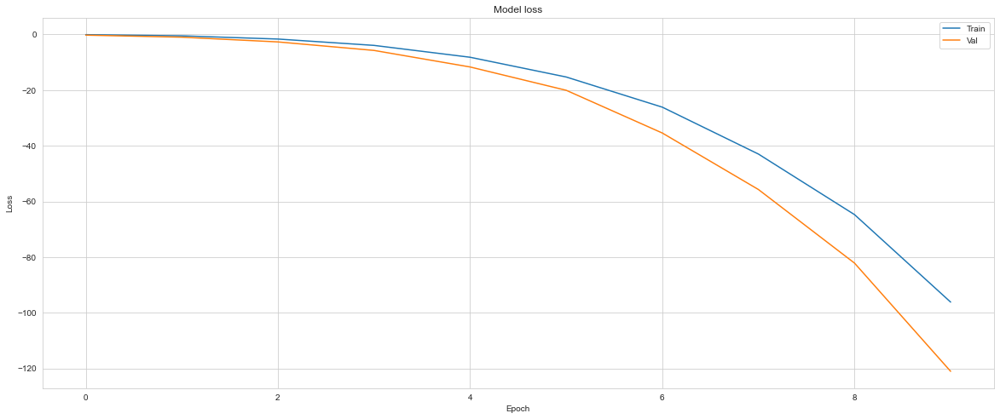

In [81]:
# showing a plot of the loss with respect to the number of epochs 
plt.figure(figsize=(20, 8))
plt.grid(True)
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val'], loc='upper right')
plt.show() 